In [1]:
%load_ext autoreload
%autoreload 2
%pylab inline
pylab.rcParams['figure.figsize'] = (20, 20)

import numpy as np
import cv2
import os
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import skimage.feature as skimg
import sklearn
from common import showImages
from feature import Feature
from train import Classifier
from train import Trainer
from search import Search

Populating the interactive namespace from numpy and matplotlib


In [86]:
# load vehicle data
v_paths = glob.glob('./data/vehicles/*.png')
nv_paths = glob.glob('./data/non-vehicles/*.png')

print("Number of vehicle samples: ", len(v_paths))
print("Number of non-vehicle samples: ", len(nv_paths))

Number of vehicle samples:  5394
Number of non-vehicle samples:  8968


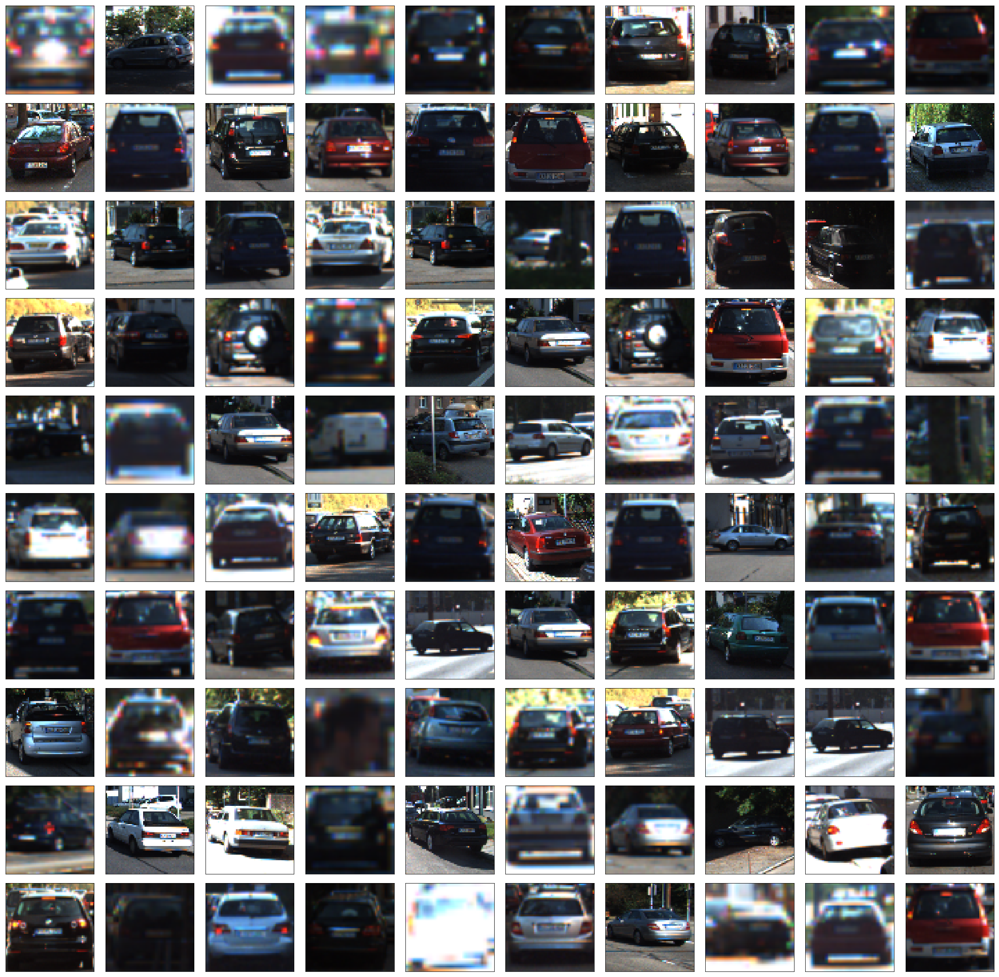

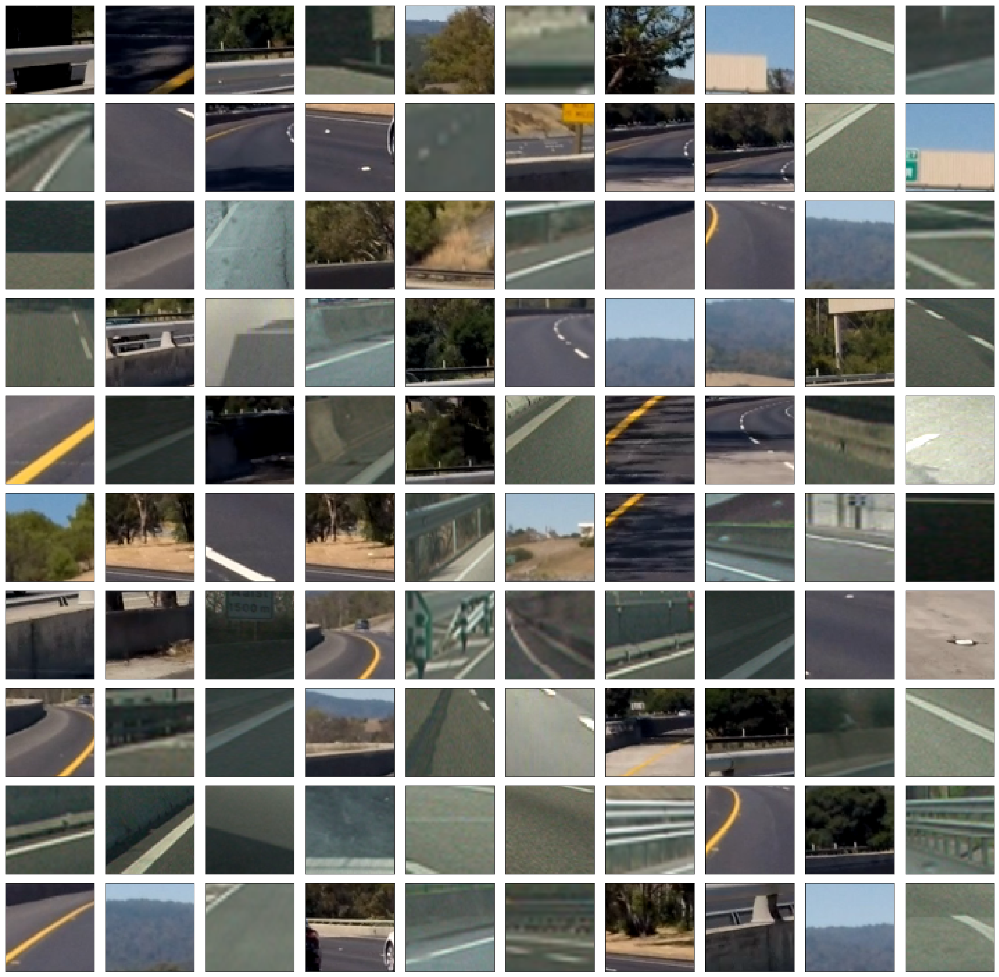

Max image dimension =  64
Image pixel range 0.0 1.0


In [59]:
# load random sample of images
v_imgs = []
nv_imgs = []

imgs_row = 10
imgs_col = 10
v_sample = np.random.choice(len(v_paths), imgs_row * imgs_col)
nv_sample = np.random.choice(len(nv_paths), imgs_row * imgs_col)

v_shapes = []
nv_shapes = []

for i in v_sample:
    v_imgs.append(mpimg.imread(v_paths[i])) 
    v_shapes.append(v_imgs[-1].shape)
for i in nv_sample:
    nv_imgs.append(mpimg.imread(nv_paths[i]))
    nv_shapes.append(nv_imgs[-1].shape)
        
showImages(v_imgs, imgs_row, imgs_col)
showImages(nv_imgs, imgs_row, imgs_col)

print("Max image dimension = ", np.max(v_shapes))
print("Image pixel range", np.min(v_imgs), np.max(v_imgs))

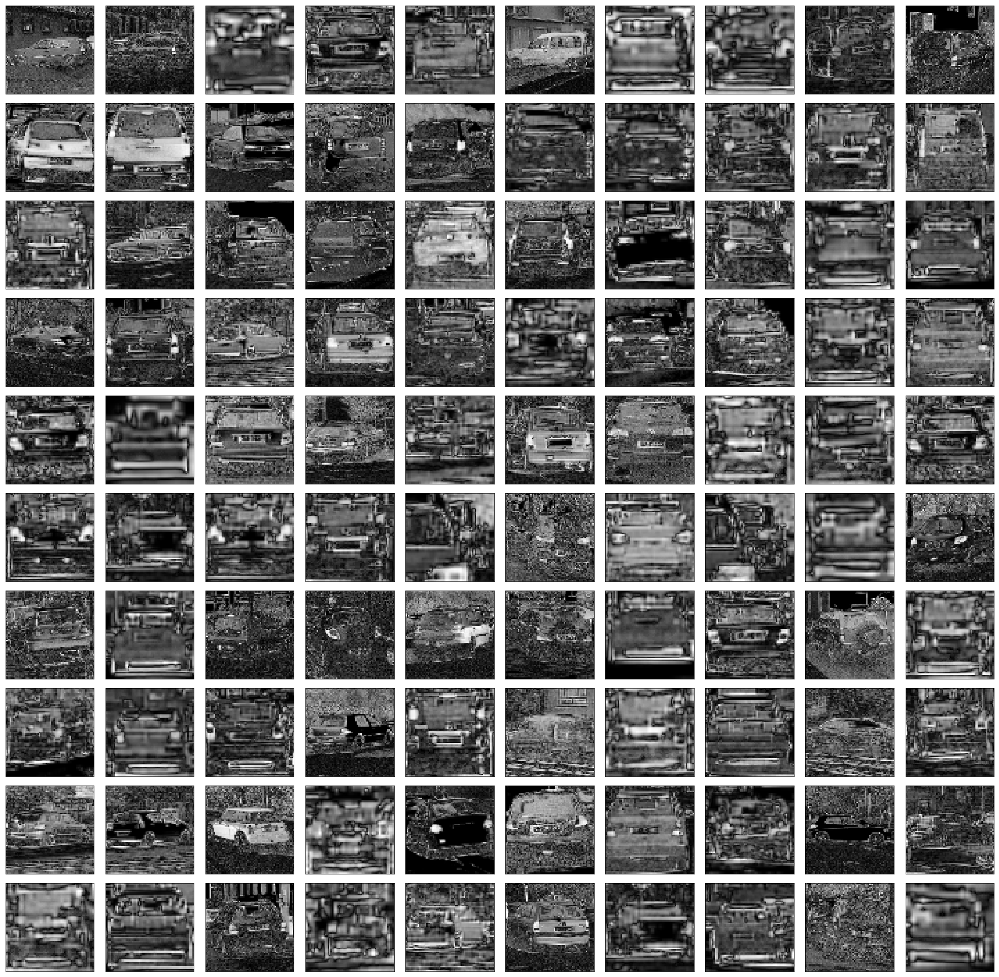

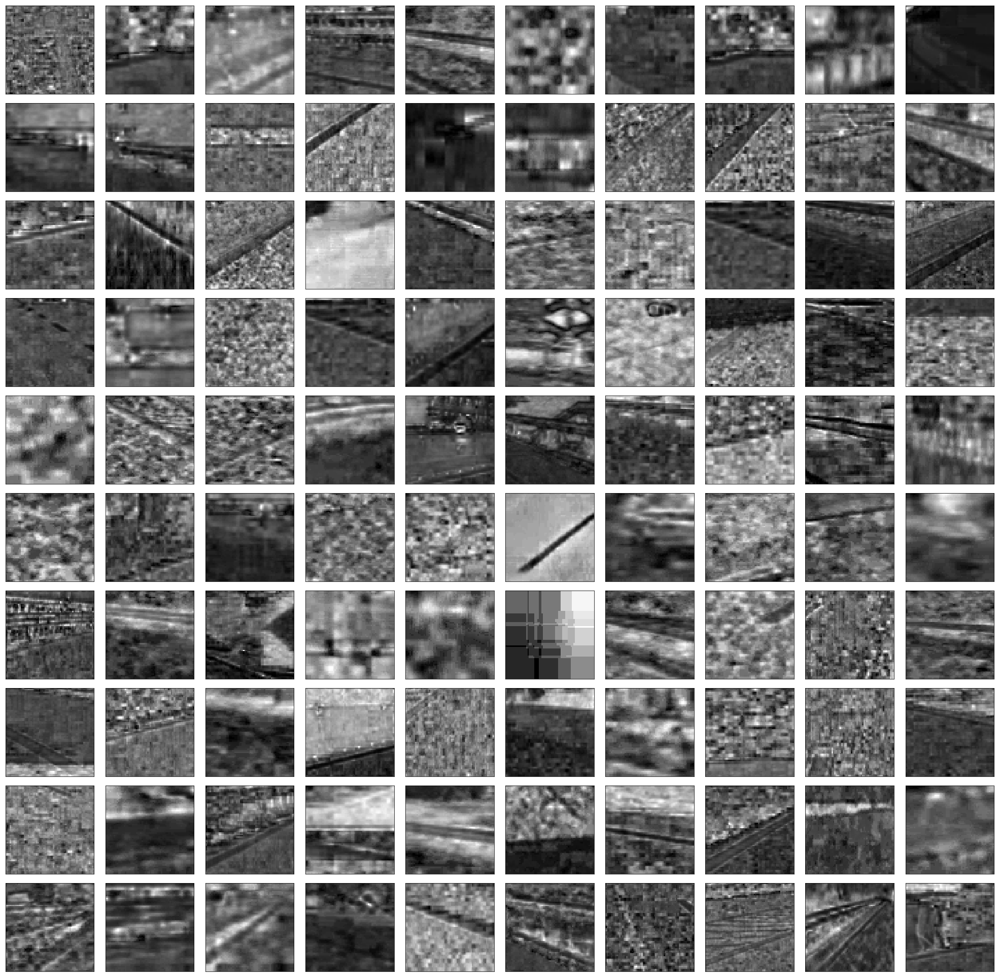

In [379]:
# hsv color space
v_hsv_imgs = []
nv_hsv_imgs = []

for img in v_imgs:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    #normalize hue between 0-1.0
    img[:,:,0] = np.array(img[:,:,0]) / 360.0
    v_hsv_imgs.append(img)
for img in nv_imgs:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    #normalize hue between 0-1.0
    img[:,:,0] = np.array(img[:,:,0]) / 360.0
    nv_hsv_imgs.append(img)
    
v_hsv_imgs = np.array(v_hsv_imgs)
nv_hsv_imgs = np.array(nv_hsv_imgs)
     
showImages(v_hsv_imgs[:,:,:,1], imgs_row, imgs_col, cmap='gray')
showImages(nv_hsv_imgs[:,:,:,1], imgs_row, imgs_col, cmap='gray')

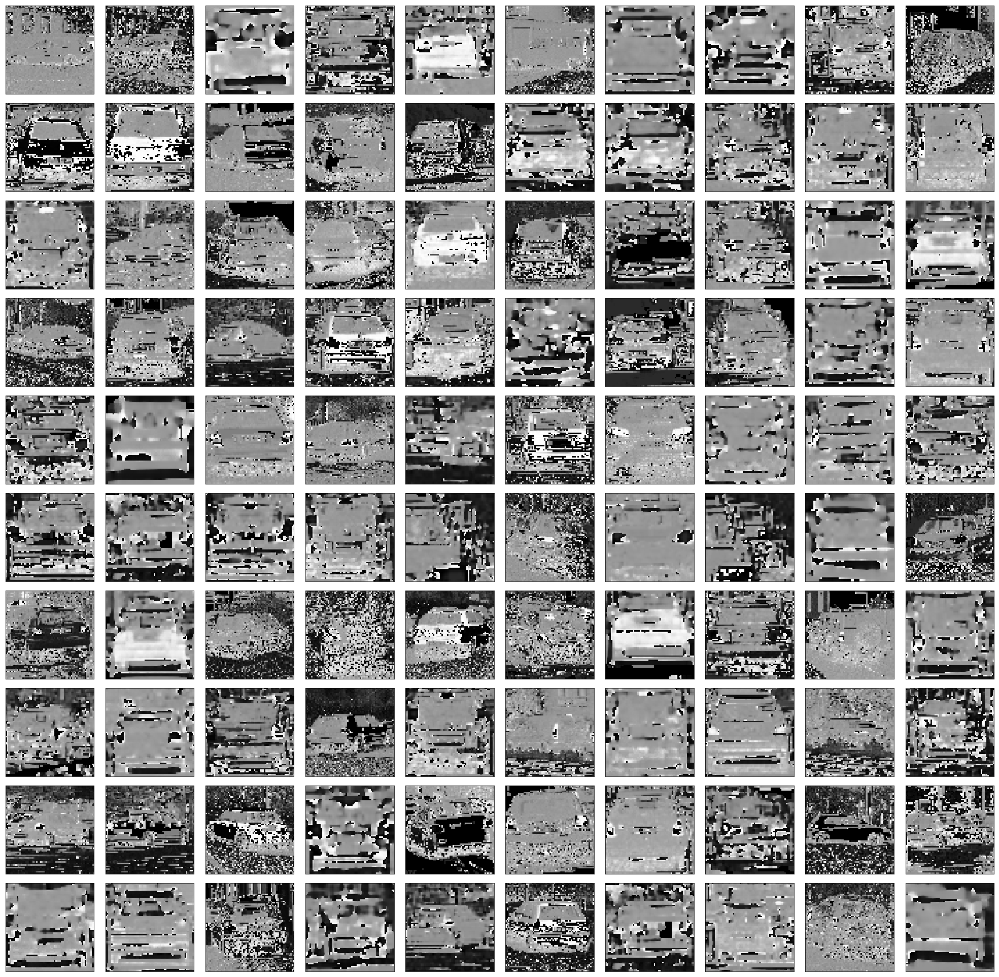

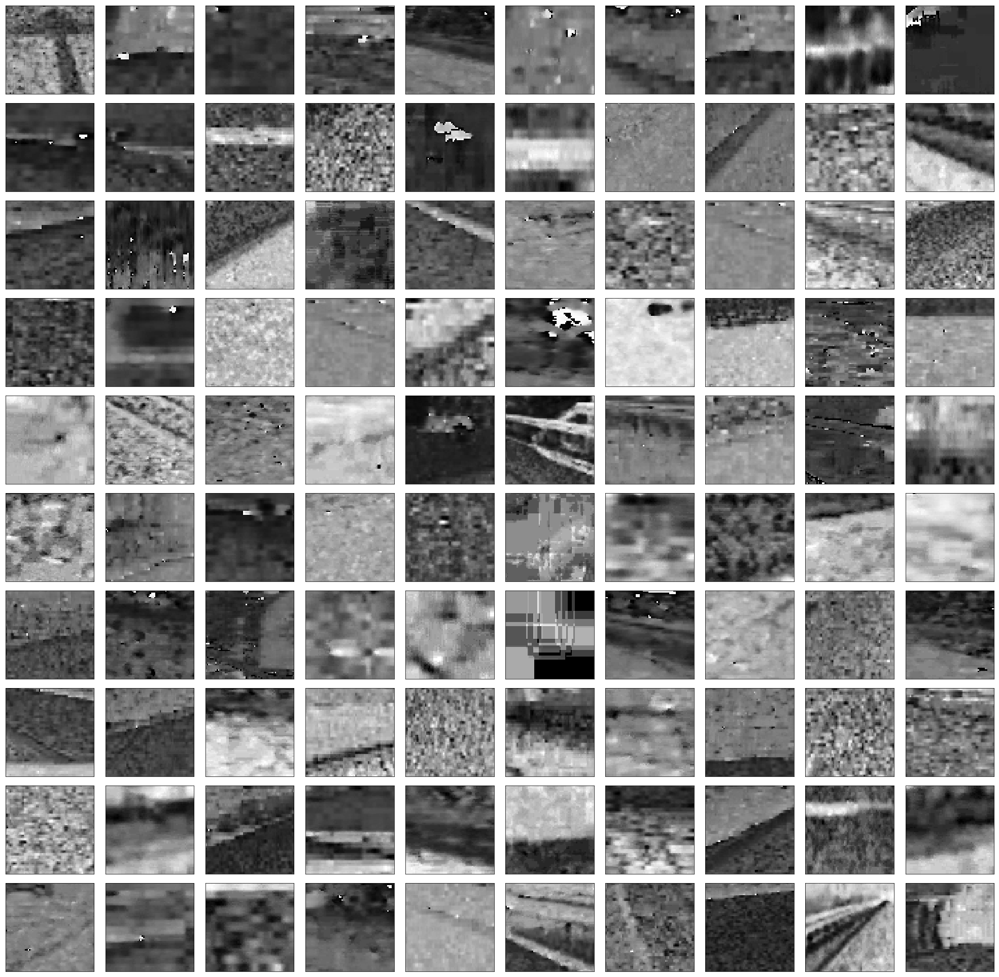

In [380]:
showImages(v_hsv_imgs[:,:,:,0], imgs_row, imgs_col, cmap='gray')
showImages(nv_hsv_imgs[:,:,:,0], imgs_row, imgs_col, cmap='gray')

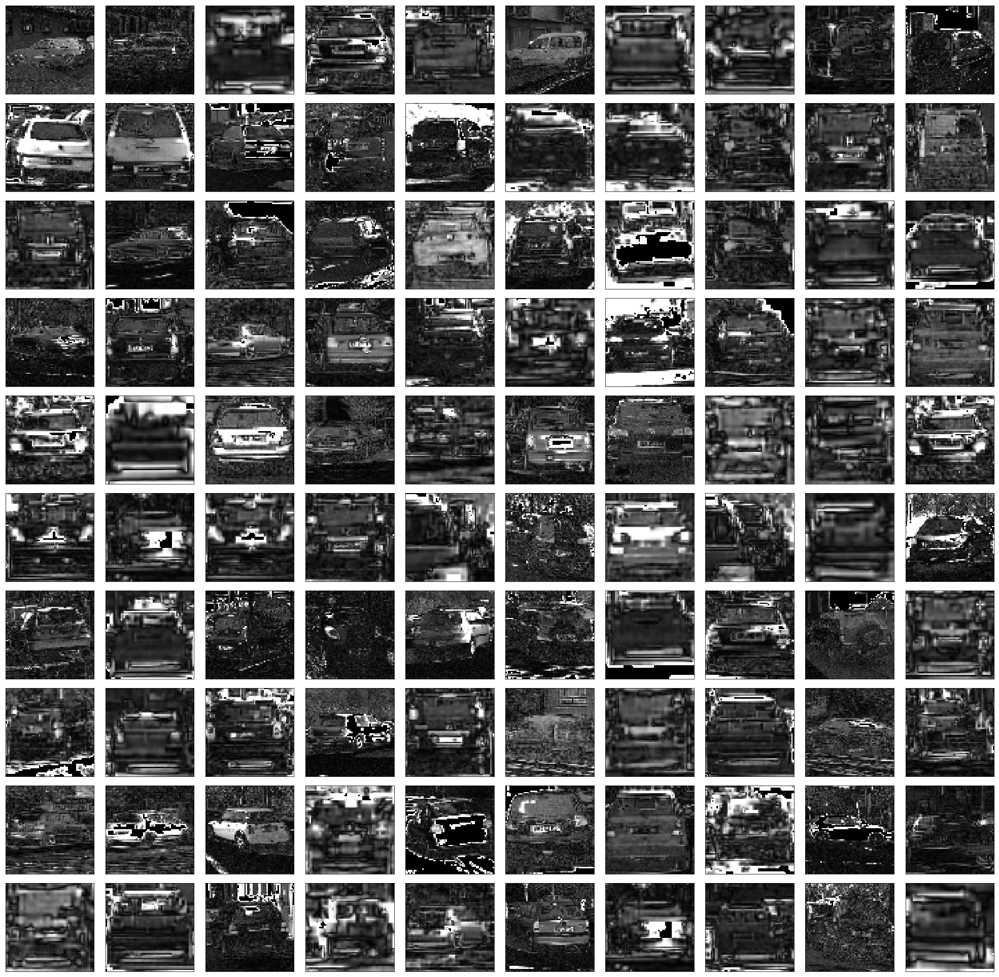

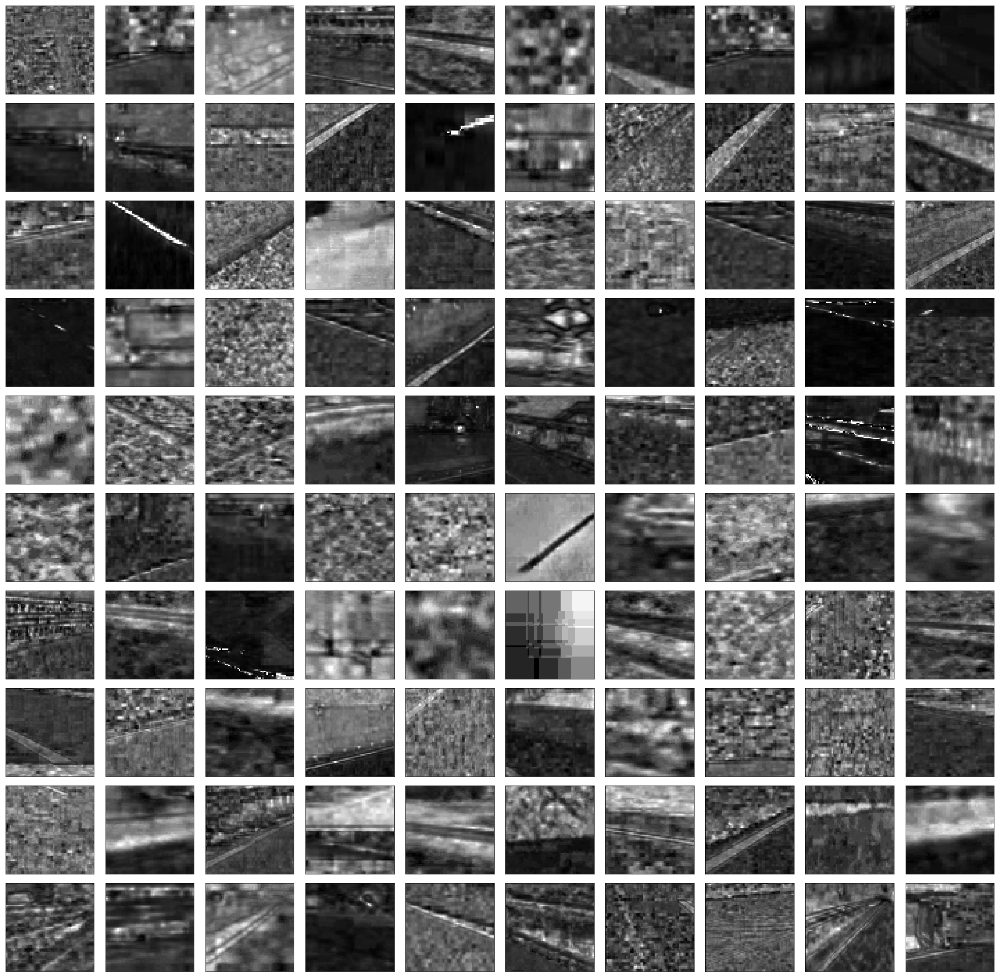

In [381]:
# hls color space
v_hls_imgs = []
nv_hls_imgs = []

for img in v_imgs:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    #normalize hue between 0-1.0
    img[:,:,0] = np.array(img)[:,:,0] / 360.0
    v_hls_imgs.append(img)

for img in nv_imgs:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    #normalize hue between 0-1.0
    img[:,:,0] = np.array(img)[:,:,0] / 360.0
    nv_hls_imgs.append(img)
    
v_hls_imgs = np.array(v_hls_imgs)
nv_hls_imgs = np.array(nv_hls_imgs)
     
showImages(v_hls_imgs[:,:,:,2], imgs_row, imgs_col, cmap='gray')
showImages(nv_hls_imgs[:,:,:,2], imgs_row, imgs_col, cmap='gray')

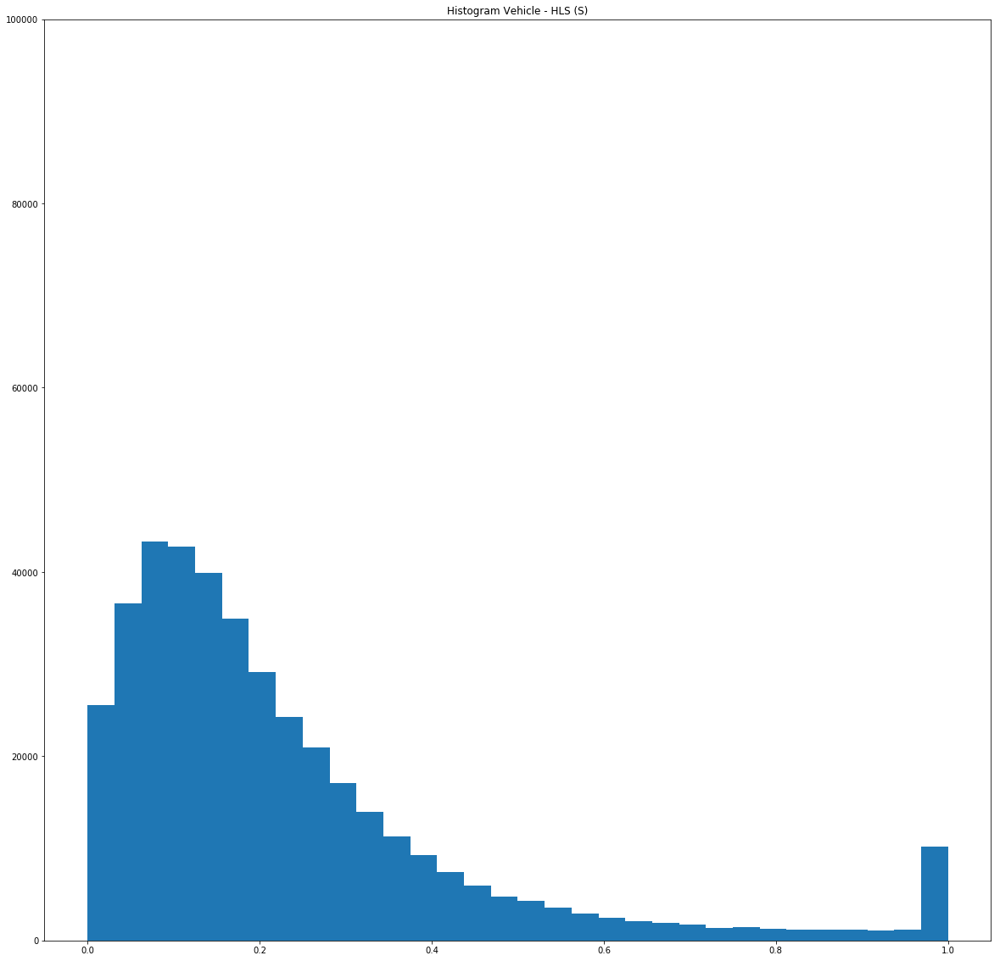

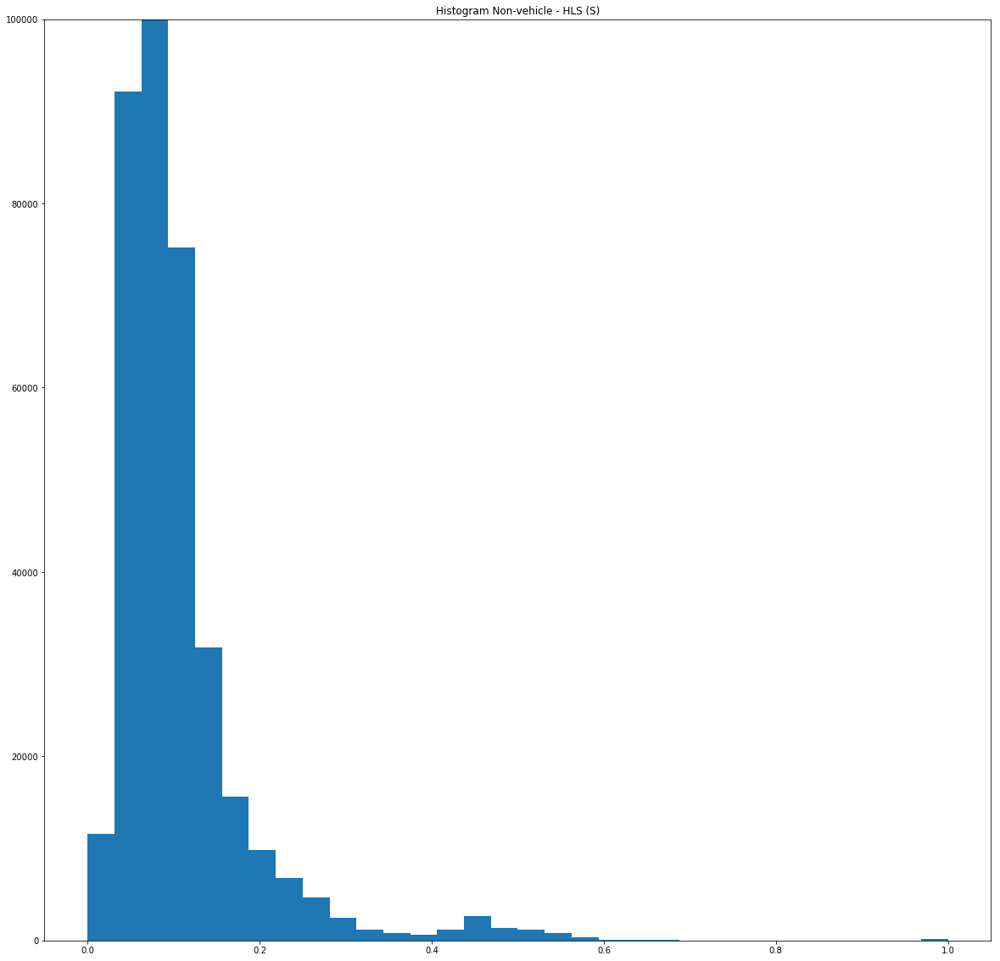

In [382]:
fig = plt.hist(v_hls_imgs[:,:,:,2].flatten(),bins=32,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,100000))
plt.title('Histogram Vehicle - HLS (S)')

plt.show()

fig = plt.hist(nv_hls_imgs[:,:,:,2].flatten(),bins=32,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,100000))
plt.title('Histogram Non-vehicle - HLS (S)')

plt.show()

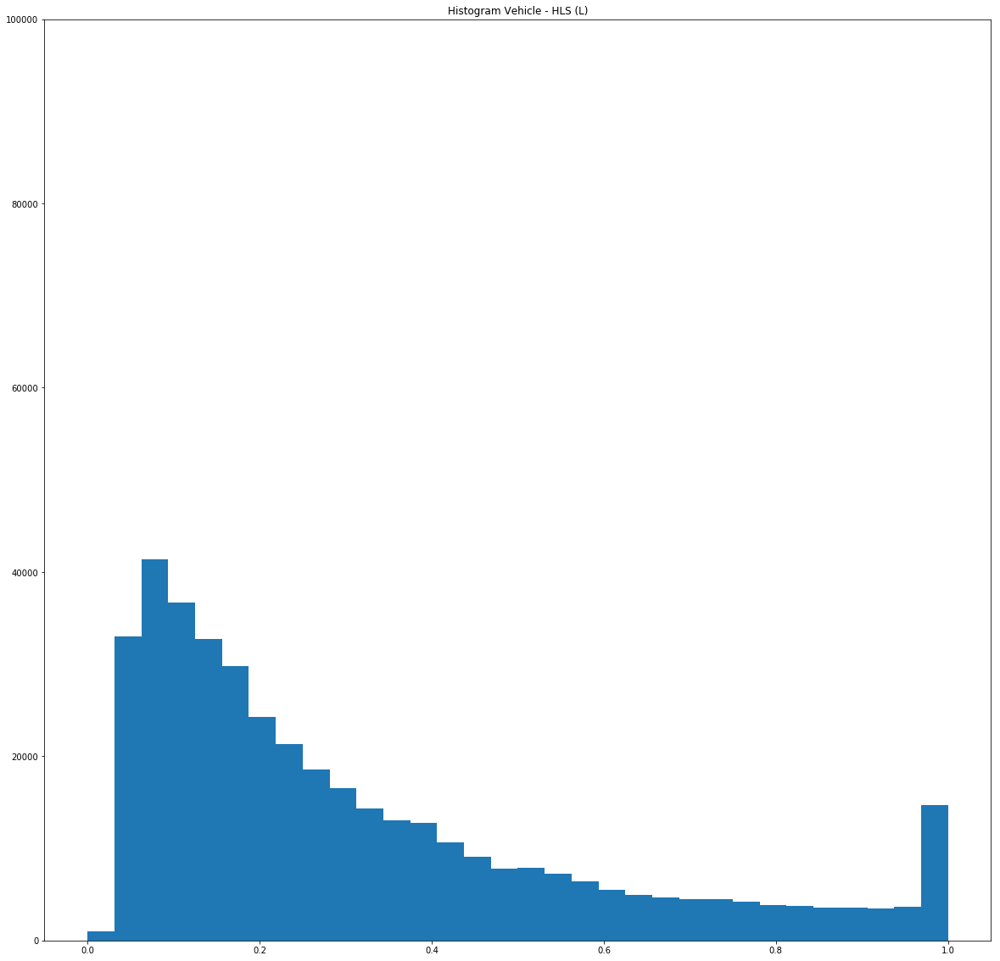

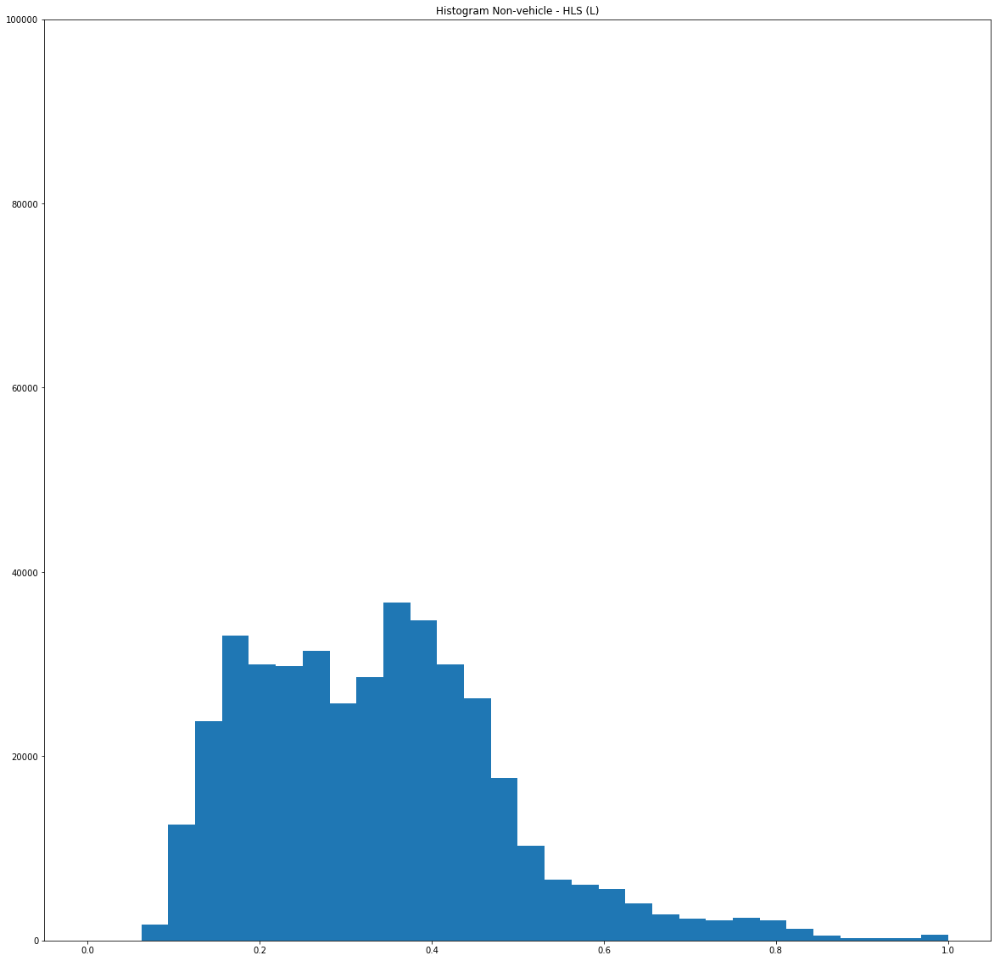

In [383]:
fig = plt.hist(v_hls_imgs[:,:,:,1].flatten(),bins=32,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,100000))
plt.title('Histogram Vehicle - HLS (L)')

plt.show()

fig = plt.hist(nv_hls_imgs[:,:,:,1].flatten(),bins=32,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,100000))
plt.title('Histogram Non-vehicle - HLS (L)')

plt.show()

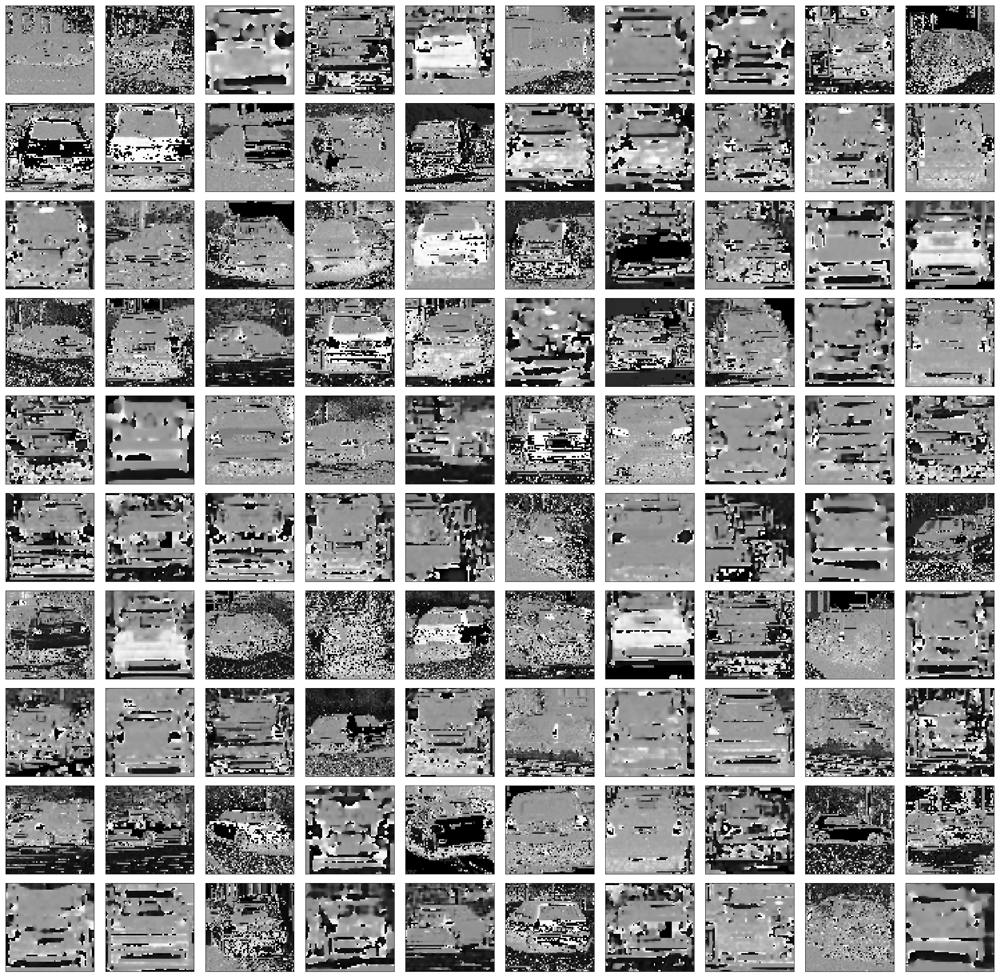

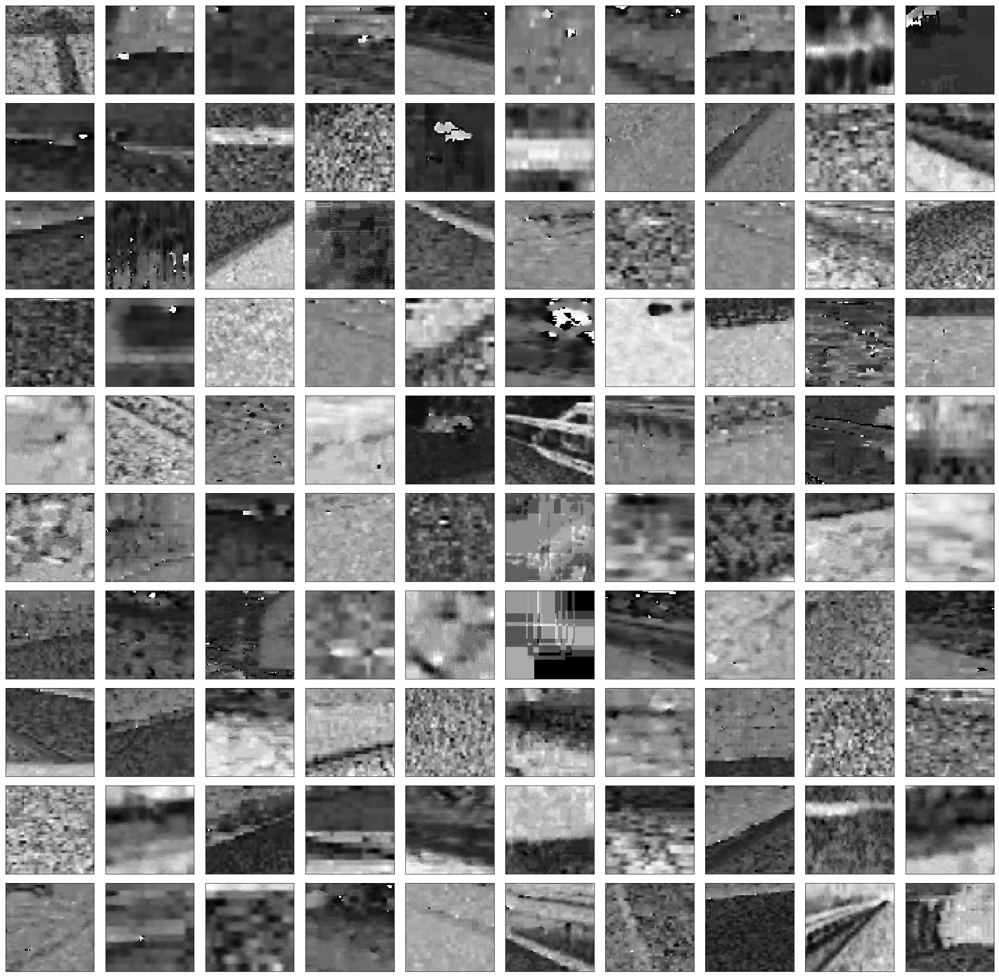

In [384]:
showImages(v_hls_imgs[:,:,:,0], imgs_row, imgs_col, cmap='gray')
showImages(nv_hls_imgs[:,:,:,0], imgs_row, imgs_col, cmap='gray')

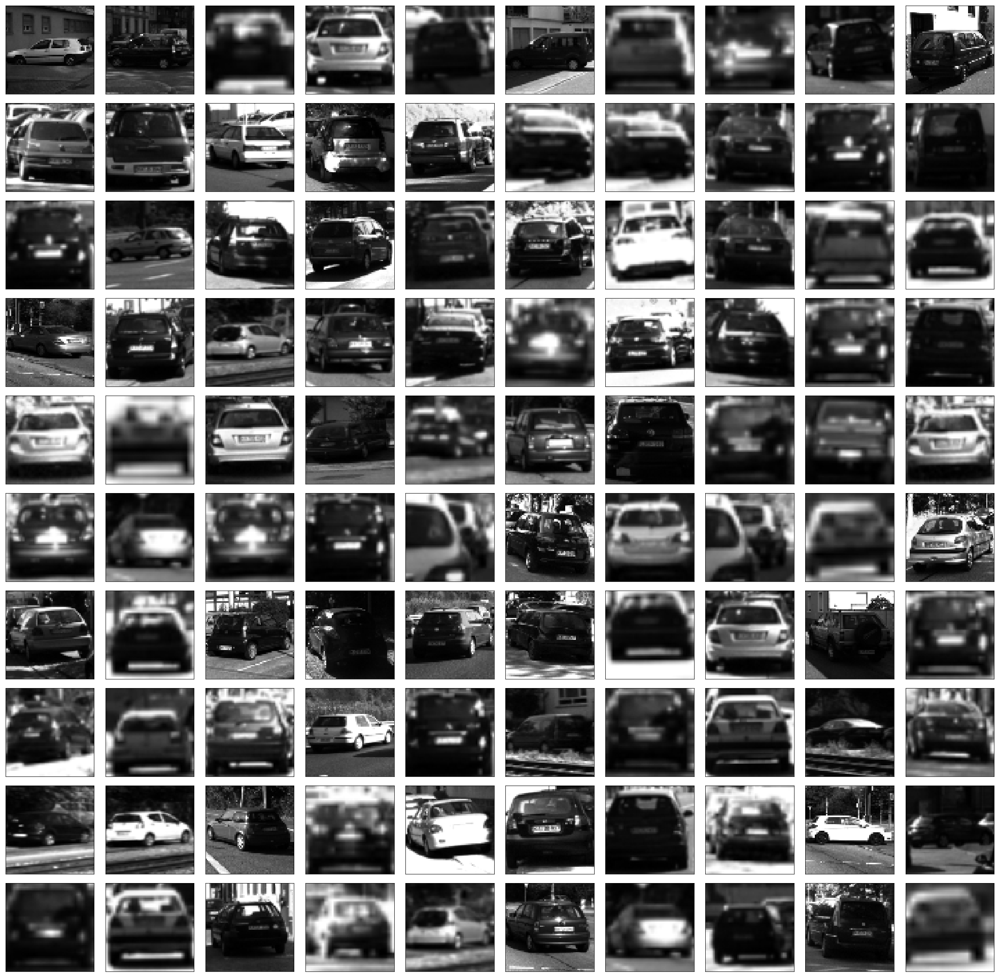

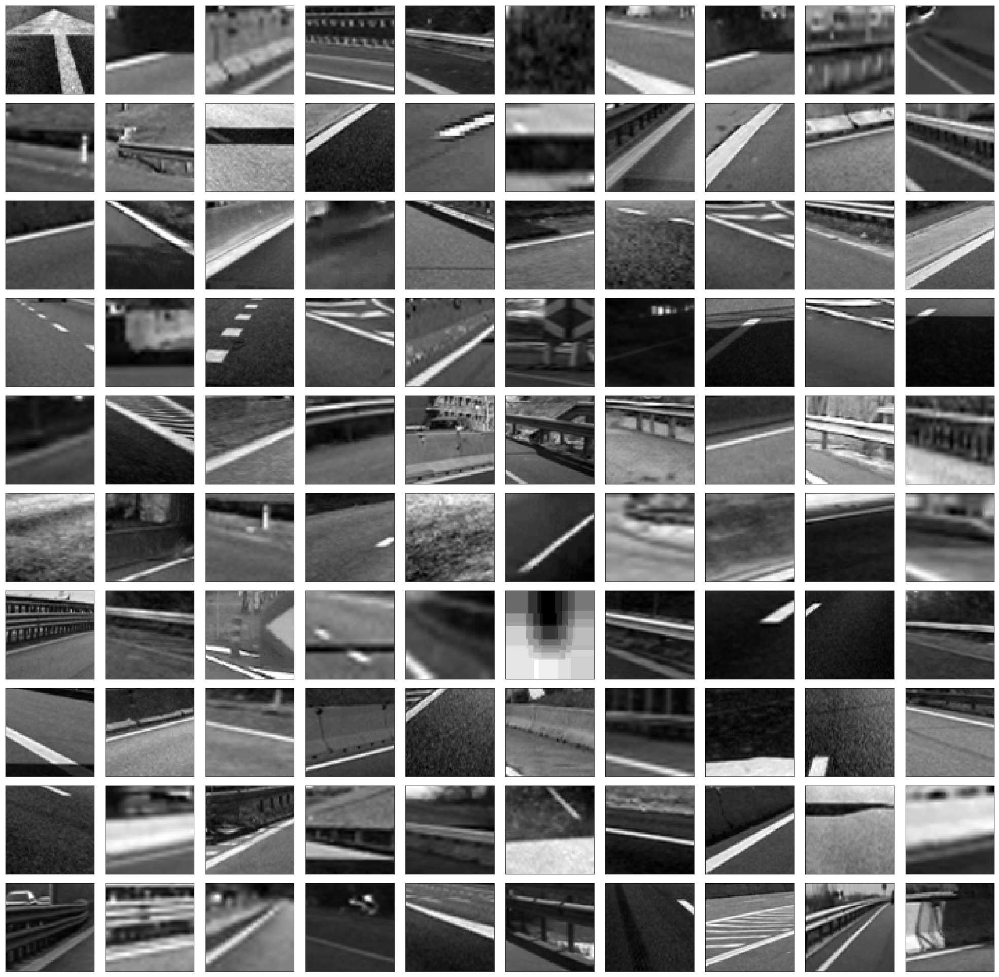

In [385]:
# yuv color space
v_yuv_imgs = []
nv_yuv_imgs = []

for img in v_imgs:
    v_yuv_imgs.append(cv2.cvtColor(img, cv2.COLOR_RGB2YUV))
for img in nv_imgs:
    nv_yuv_imgs.append(cv2.cvtColor(img, cv2.COLOR_RGB2YUV))
    
v_yuv_imgs = np.array(v_yuv_imgs)
nv_yuv_imgs = np.array(nv_yuv_imgs)
     
showImages(v_yuv_imgs[:,:,:,0], imgs_row, imgs_col, cmap='gray')
showImages(nv_yuv_imgs[:,:,:,0], imgs_row, imgs_col, cmap='gray')

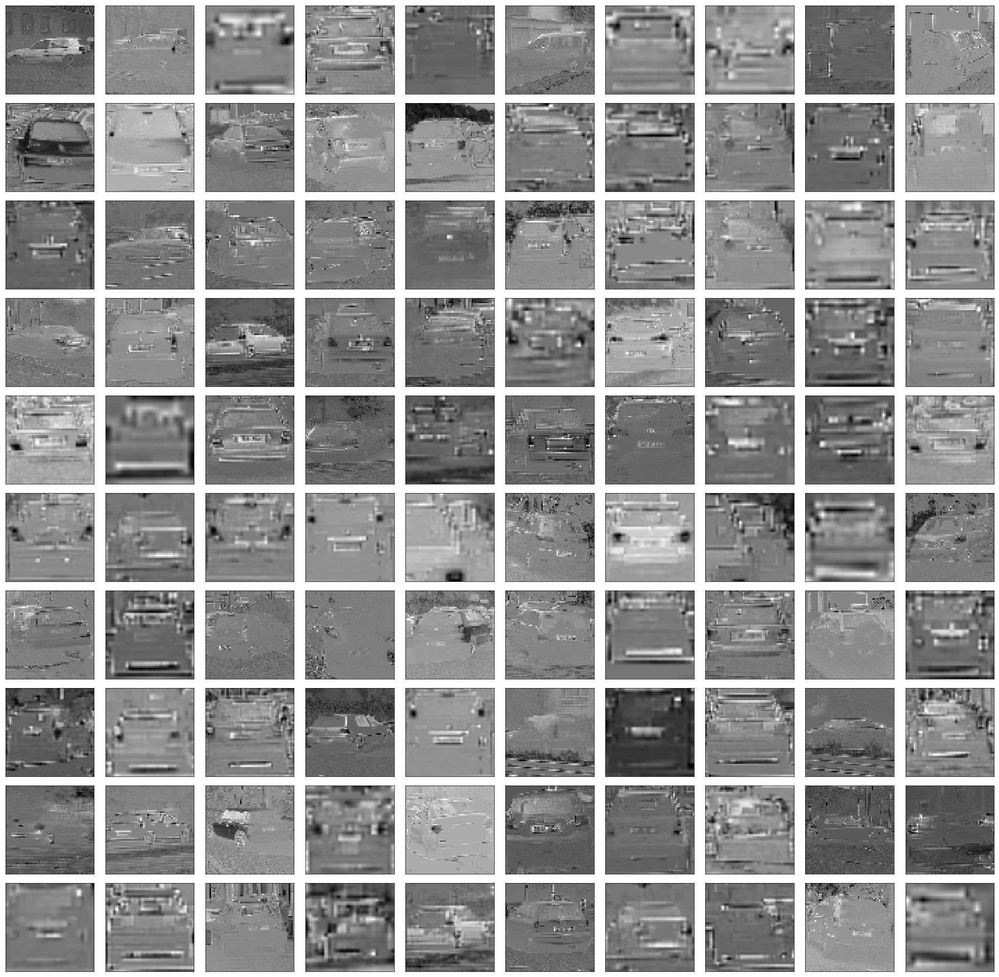

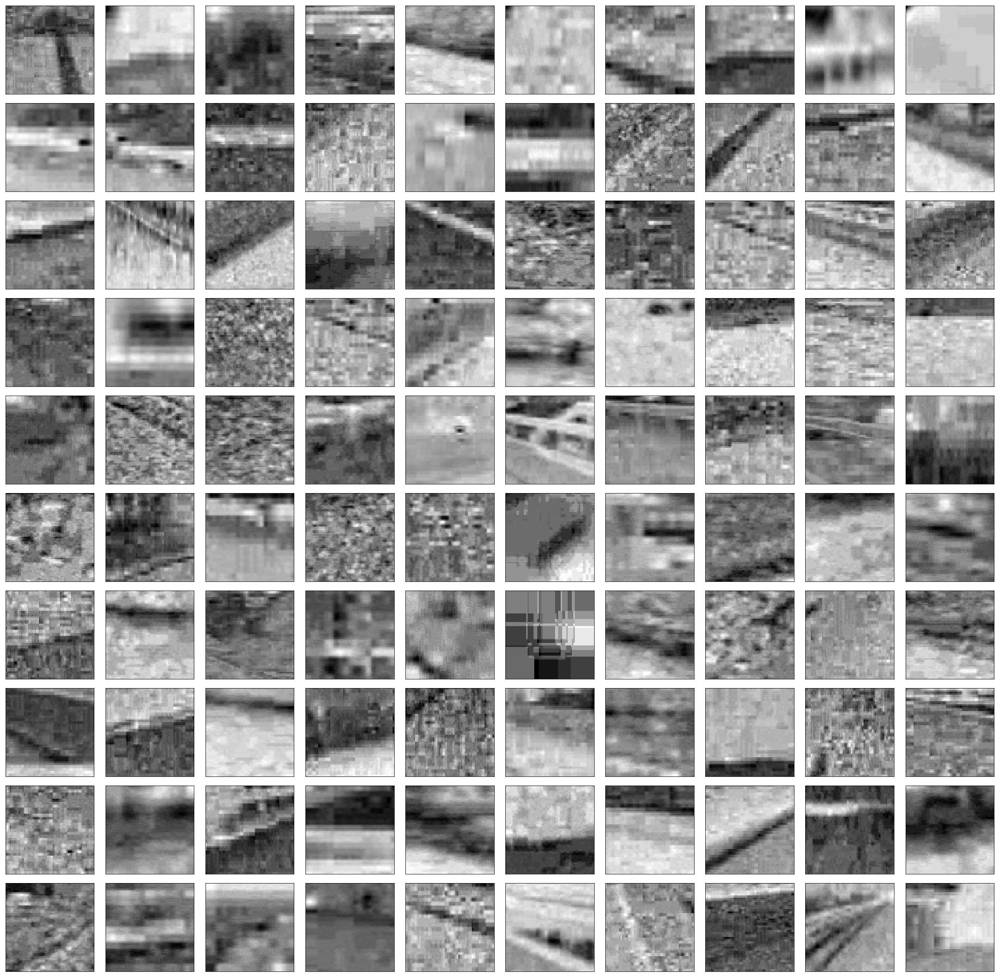

In [386]:
showImages(v_yuv_imgs[:,:,:,1], imgs_row, imgs_col, cmap='gray')
showImages(nv_yuv_imgs[:,:,:,1], imgs_row, imgs_col, cmap='gray')

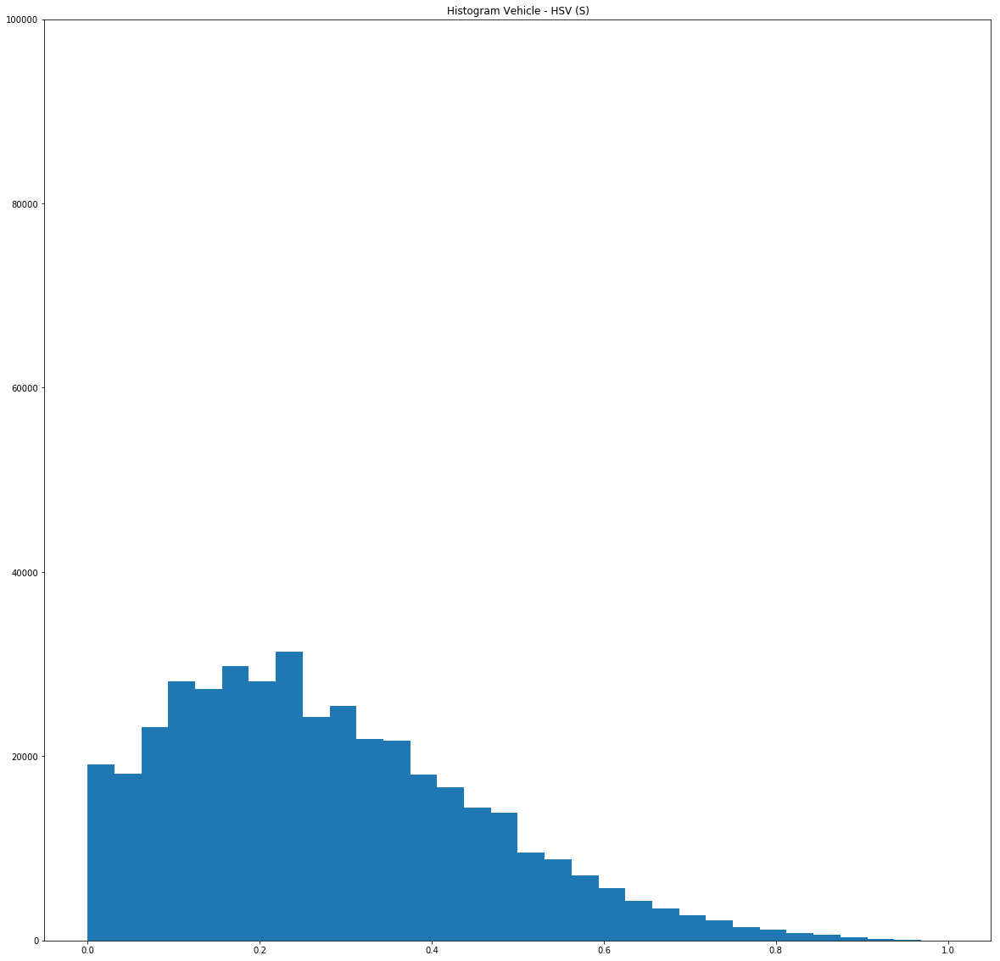

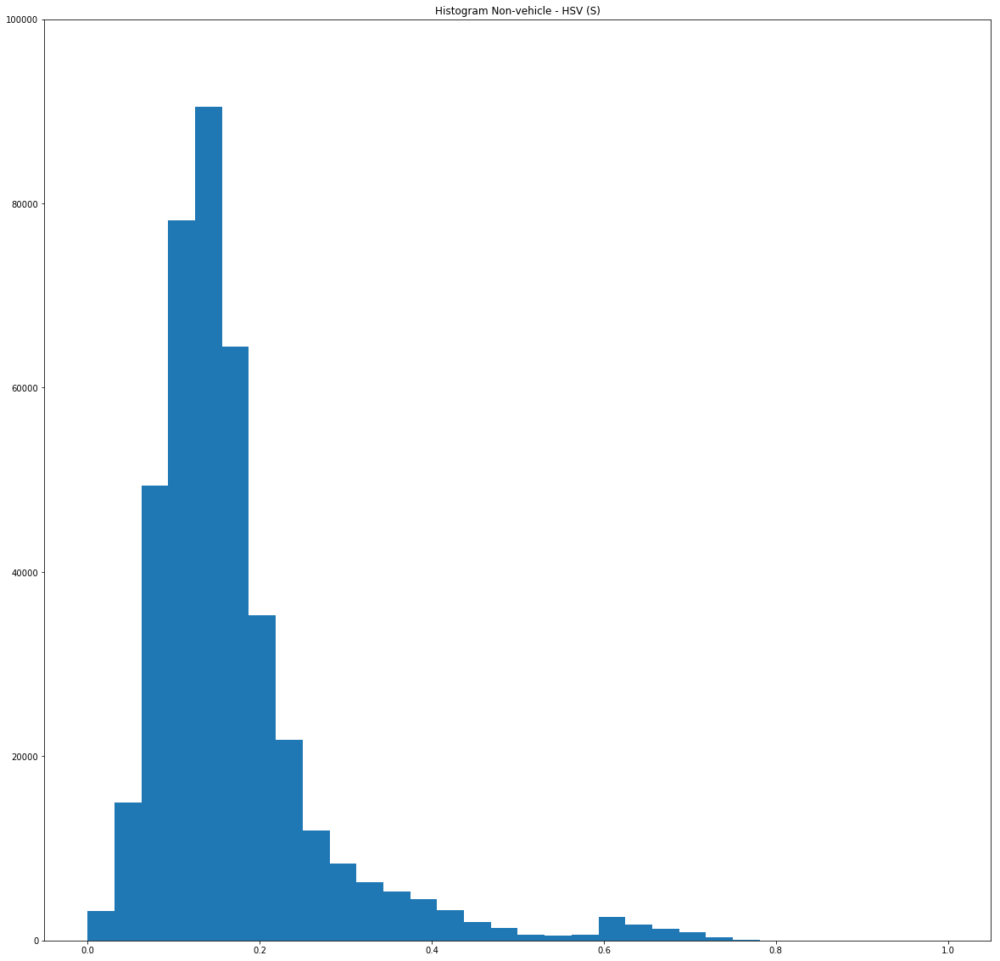

In [387]:
fig = plt.hist(v_hsv_imgs[:,:,:,1].flatten(),bins=32,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,100000))
plt.title('Histogram Vehicle - HSV (S)')

plt.show()

fig = plt.hist(nv_hsv_imgs[:,:,:,1].flatten(),bins=32,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,100000))
plt.title('Histogram Non-vehicle - HSV (S)')

plt.show()

0.0 0.999109


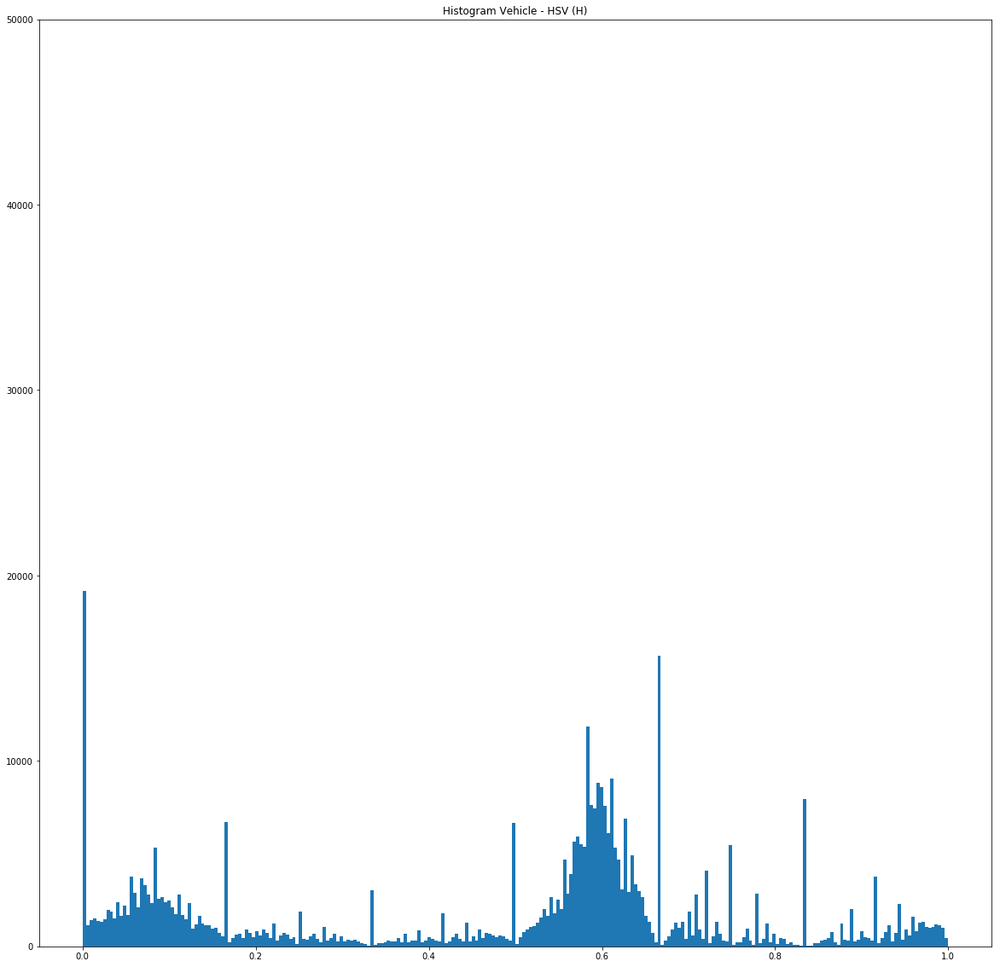

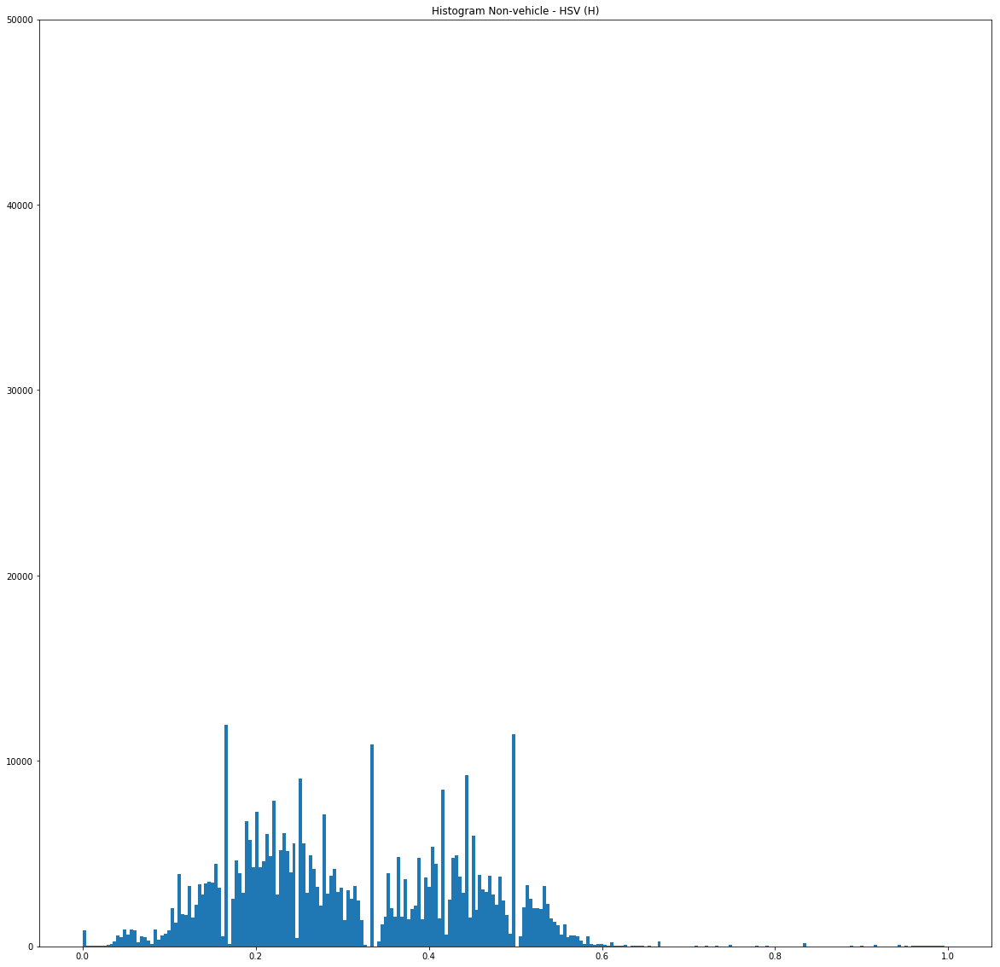

In [388]:
print(np.min(v_hsv_imgs[:,:,:,0]), np.max(v_hsv_imgs[:,:,:,0]))

fig = plt.hist(v_hsv_imgs[:,:,:,0].flatten(),bins=256,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,50000))
plt.title('Histogram Vehicle - HSV (H)')

plt.show()

fig = plt.hist(nv_hsv_imgs[:,:,:,0].flatten(),bins=256,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,50000))
plt.title('Histogram Non-vehicle - HSV (H)')

plt.show()

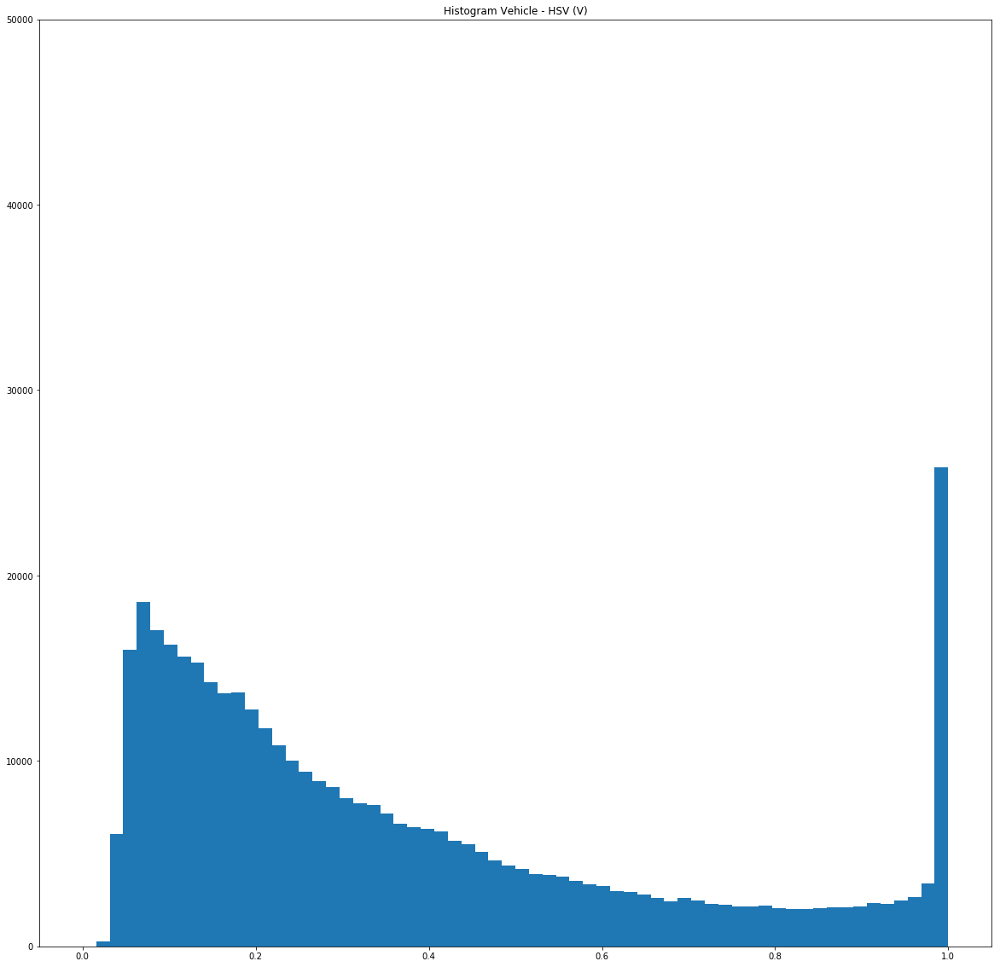

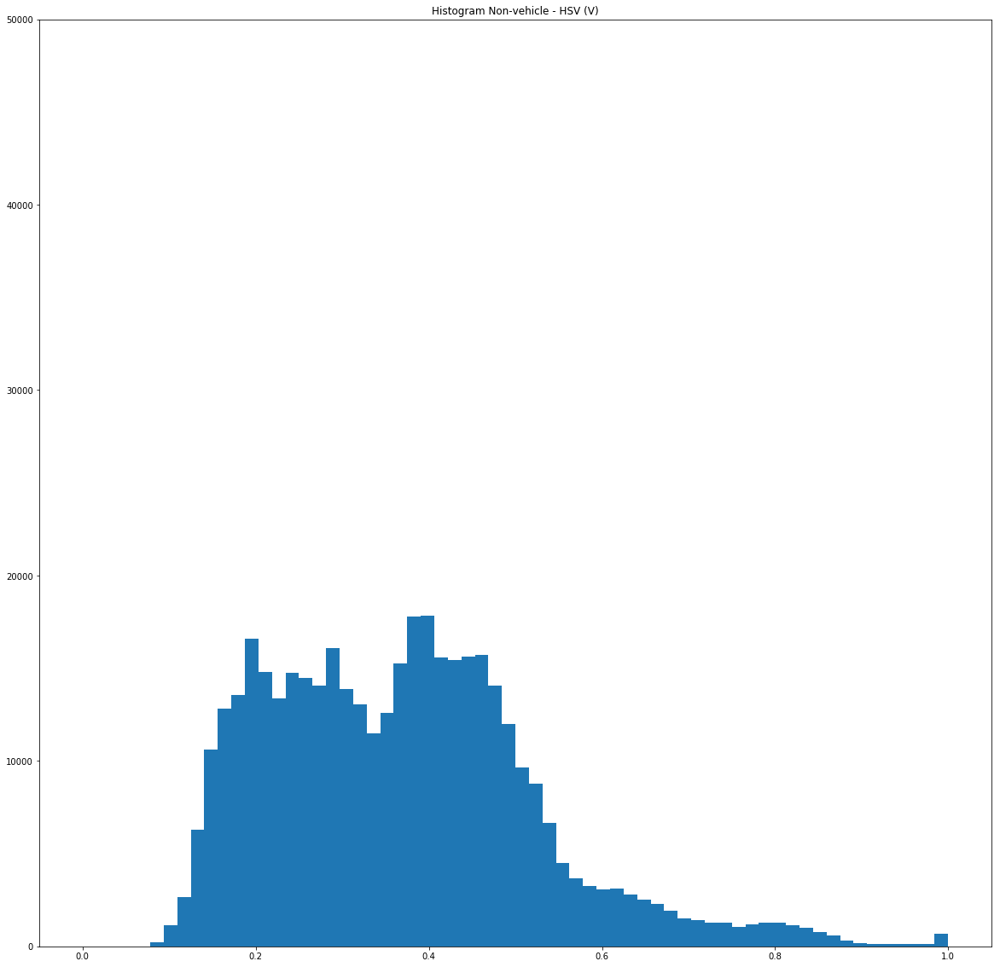

In [389]:
fig = plt.hist(v_hsv_imgs[:,:,:,2].flatten(),bins=64,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,50000))
plt.title('Histogram Vehicle - HSV (V)')

plt.show()

fig = plt.hist(nv_hsv_imgs[:,:,:,2].flatten(),bins=64,align='mid',normed=False,range=(0.,1.0))
plt.ylim((0,50000))
plt.title('Histogram Non-vehicle - HSV (V)')

plt.show()

In [390]:
pix_per_cell = 8
cell_per_block = 8
orient = 13

v_hog_hsv_s_imgs = []
v_hog_hsv_h_imgs = []
v_hog_hsv_v_imgs = []

nv_hog_hsv_s_imgs = []
nv_hog_hsv_h_imgs = []
nv_hog_hsv_v_imgs = []

v_hog_hsv_s_features = []
v_hog_hsv_h_features = []
v_hog_hsv_v_features = []

nv_hog_hsv_s_features = []
nv_hog_hsv_h_features = []
nv_hog_hsv_v_features = []

v_hog_hls_s_imgs = []
v_hog_hls_h_imgs = []
v_hog_hls_v_imgs = []

nv_hog_hls_s_imgs = []
nv_hog_hls_h_imgs = []
nv_hog_hls_v_imgs = []

v_hog_hls_s_features = []
v_hog_hls_h_features = []
v_hog_hls_v_features = []

nv_hog_hls_s_features = []
nv_hog_hls_h_features = []
nv_hog_hls_v_features = []

for img in v_hsv_imgs:
    features, hog = skimg.hog(img[:,:,0], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    v_hog_hsv_h_imgs.append(hog)
    v_hog_hsv_h_features.append(features)
    features, hog = skimg.hog(img[:,:,1], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    v_hog_hsv_s_imgs.append(hog)
    v_hog_hsv_s_features.append(features)
    features, hog = skimg.hog(img[:,:,2], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    v_hog_hsv_v_imgs.append(hog)
    v_hog_hsv_v_features.append(features)
    
for img in nv_hsv_imgs:
    features, hog = skimg.hog(img[:,:,0], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    nv_hog_hsv_h_imgs.append(hog)
    nv_hog_hsv_h_features.append(features)
    features, hog = skimg.hog(img[:,:,1], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    nv_hog_hsv_s_imgs.append(hog)
    nv_hog_hsv_s_features.append(features)    
    features, hog = skimg.hog(img[:,:,2], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    nv_hog_hsv_v_imgs.append(hog)    
    nv_hog_hsv_v_features.append(features)    
    
for img in v_hls_imgs:
    features, hog = skimg.hog(img[:,:,0], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    v_hog_hls_h_imgs.append(hog)
    v_hog_hls_h_features.append(features)
    features, hog = skimg.hog(img[:,:,2], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    v_hog_hls_s_imgs.append(hog)
    v_hog_hls_s_features.append(features)
    features, hog = skimg.hog(img[:,:,1], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    v_hog_hls_v_imgs.append(hog)
    v_hog_hls_v_features.append(features)
    
for img in nv_hls_imgs:
    features, hog = skimg.hog(img[:,:,0], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    nv_hog_hls_h_imgs.append(hog)
    nv_hog_hls_h_features.append(features)
    features, hog = skimg.hog(img[:,:,2], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    nv_hog_hls_s_imgs.append(hog)
    nv_hog_hls_s_features.append(features)    
    features, hog = skimg.hog(img[:,:,1], orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=True, feature_vector=False)
    nv_hog_hls_v_imgs.append(hog)    
    nv_hog_hls_v_features.append(features)        

0.355244465172 0.0


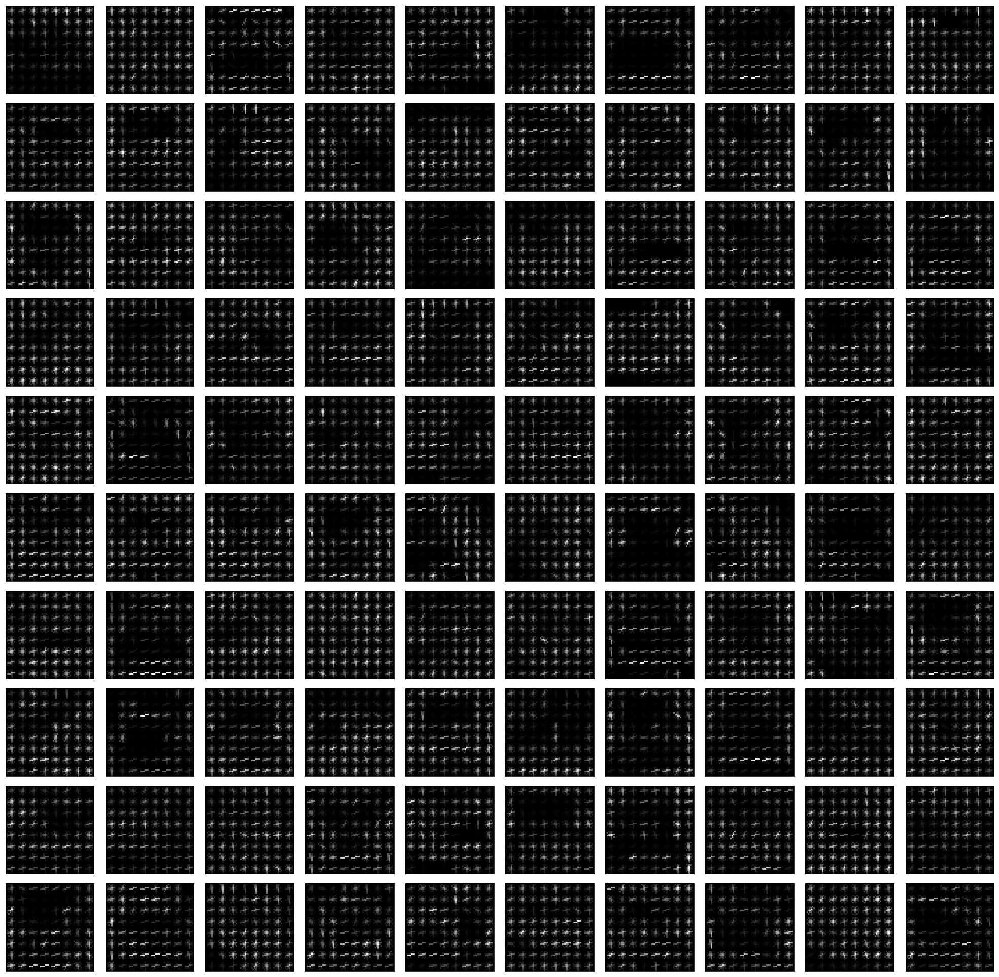

In [391]:
print(np.max(v_hog_hsv_h_imgs[0]), np.min(v_hog_hsv_h_imgs[0]))
showImages(v_hog_hsv_h_imgs, imgs_row, imgs_col, cmap='gray')

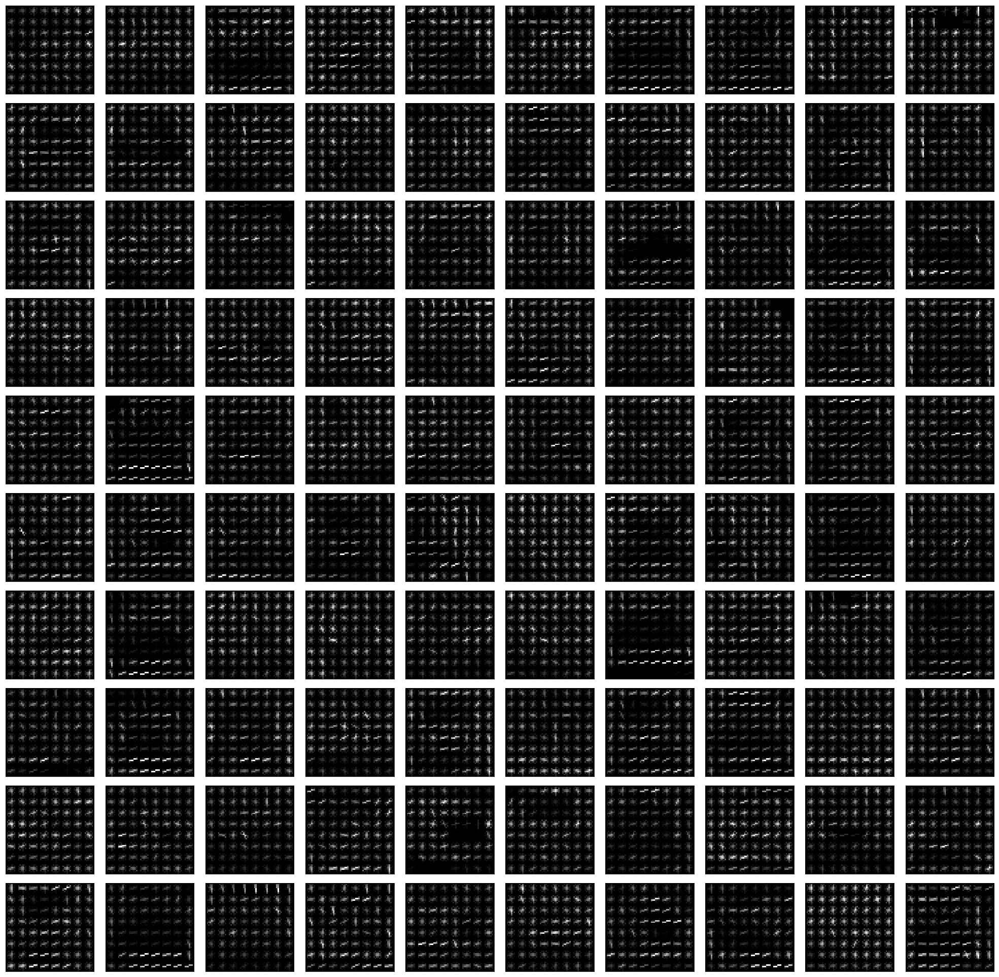

In [392]:
showImages(v_hog_hsv_s_imgs, imgs_row, imgs_col, cmap='gray')

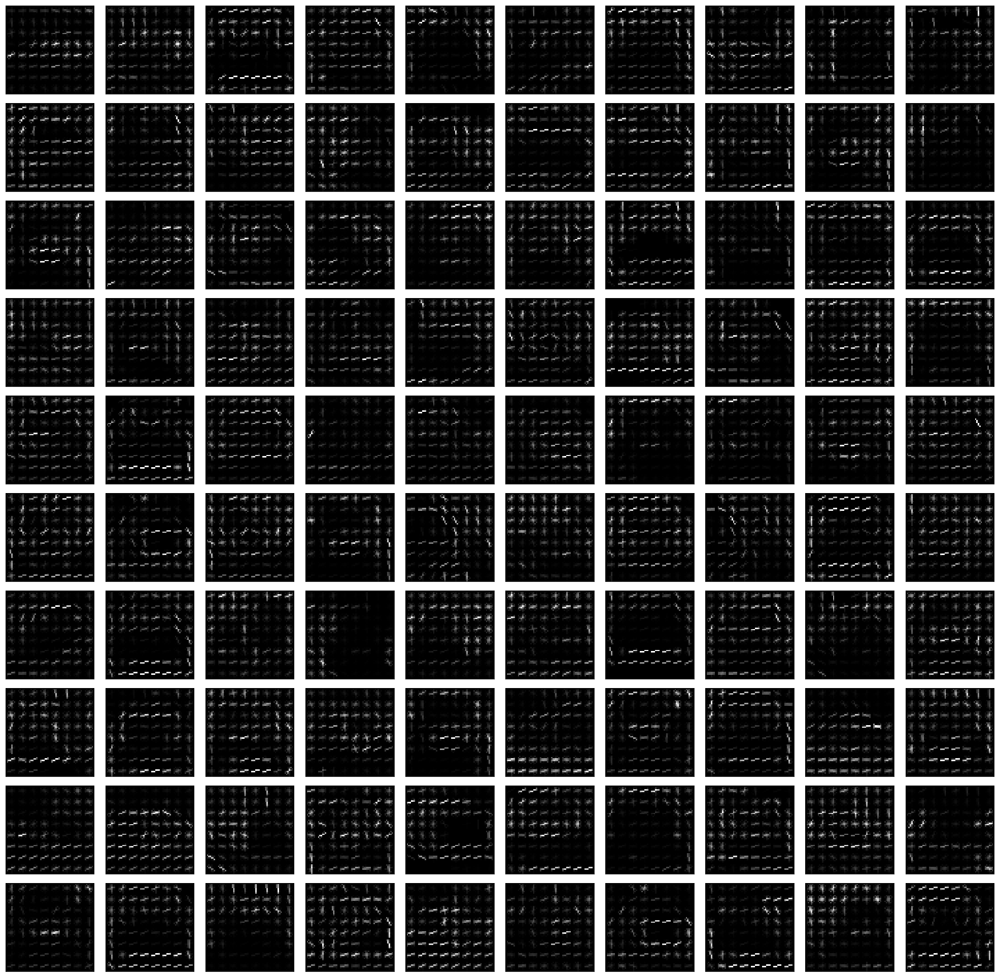

In [393]:
showImages(v_hog_hsv_v_imgs, imgs_row, imgs_col, cmap='gray')

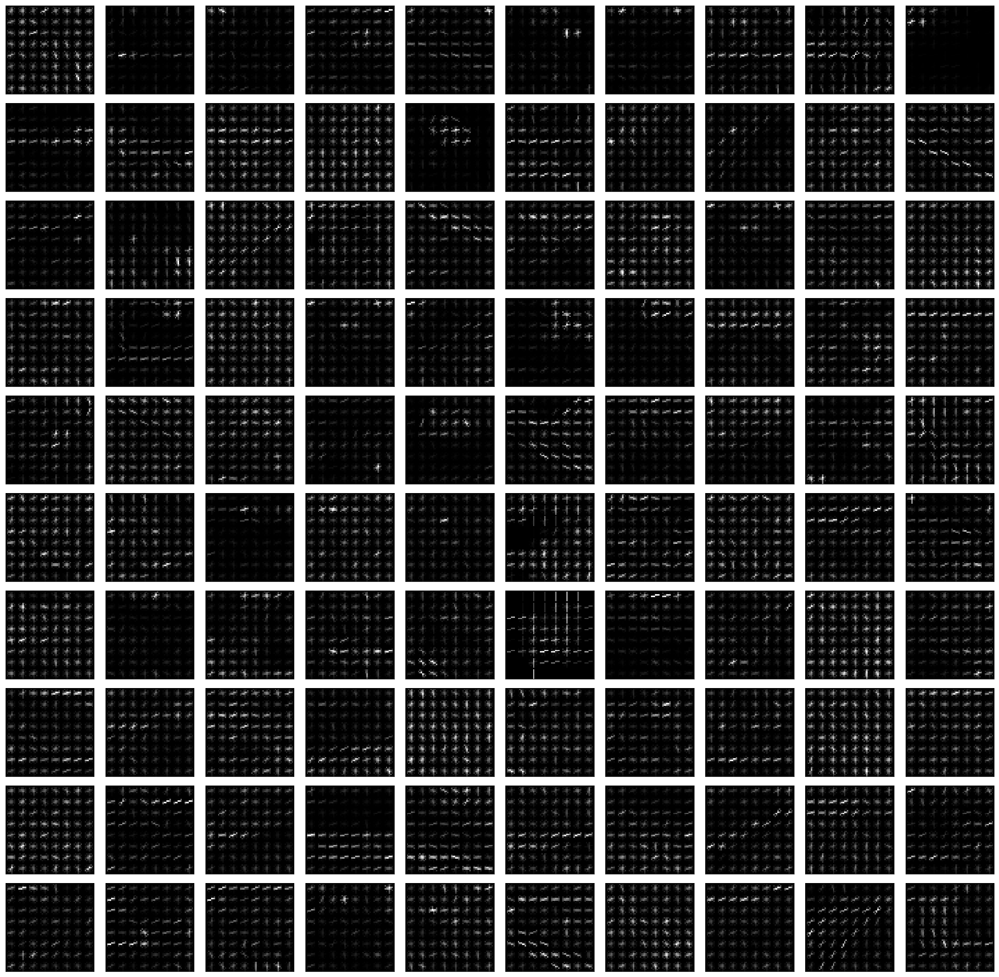

In [394]:
showImages(nv_hog_hsv_h_imgs, imgs_row, imgs_col, cmap='gray')

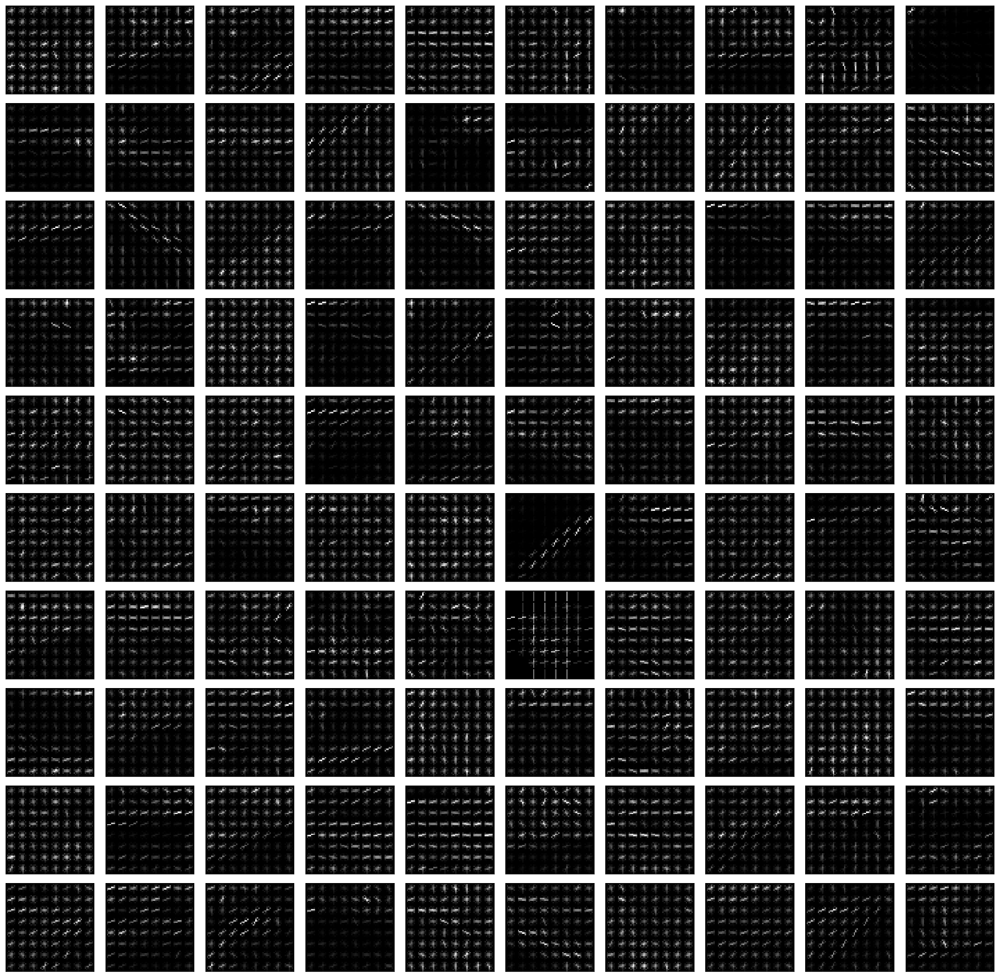

In [395]:
showImages(nv_hog_hsv_s_imgs, imgs_row, imgs_col, cmap='gray')

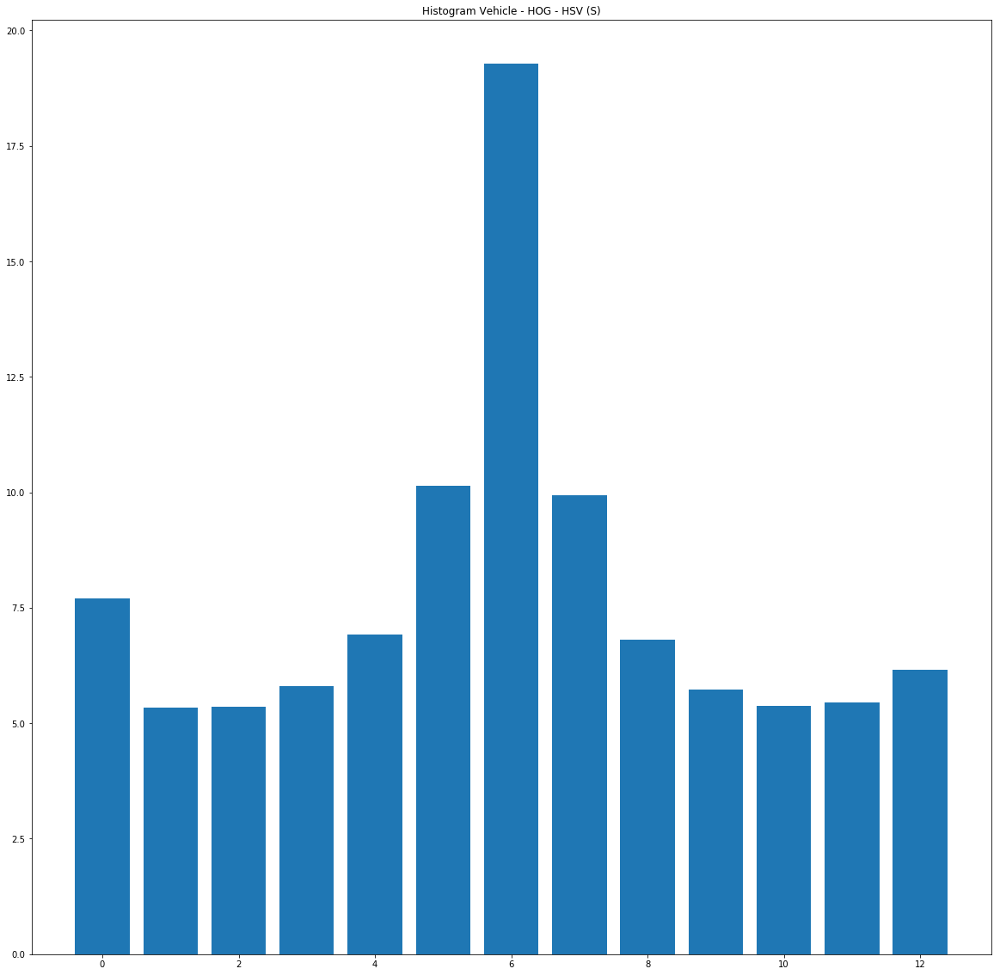

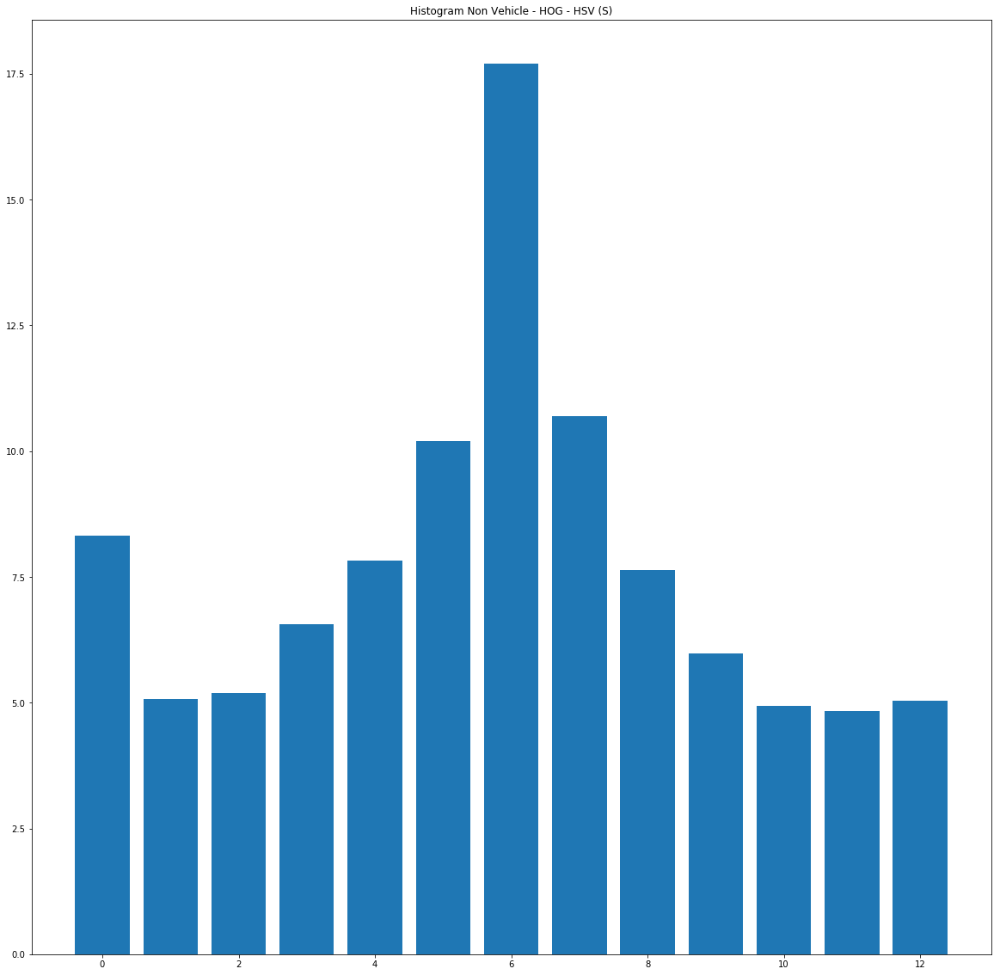

In [396]:
bars=np.arange(0,orient)
fig = plt.bar(bars, np.sum(np.array(v_hog_hsv_s_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Vehicle - HOG - HSV (S)')

plt.show()

fig = plt.bar(bars, np.sum(np.array(nv_hog_hsv_s_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Non Vehicle - HOG - HSV (S)')

plt.show()

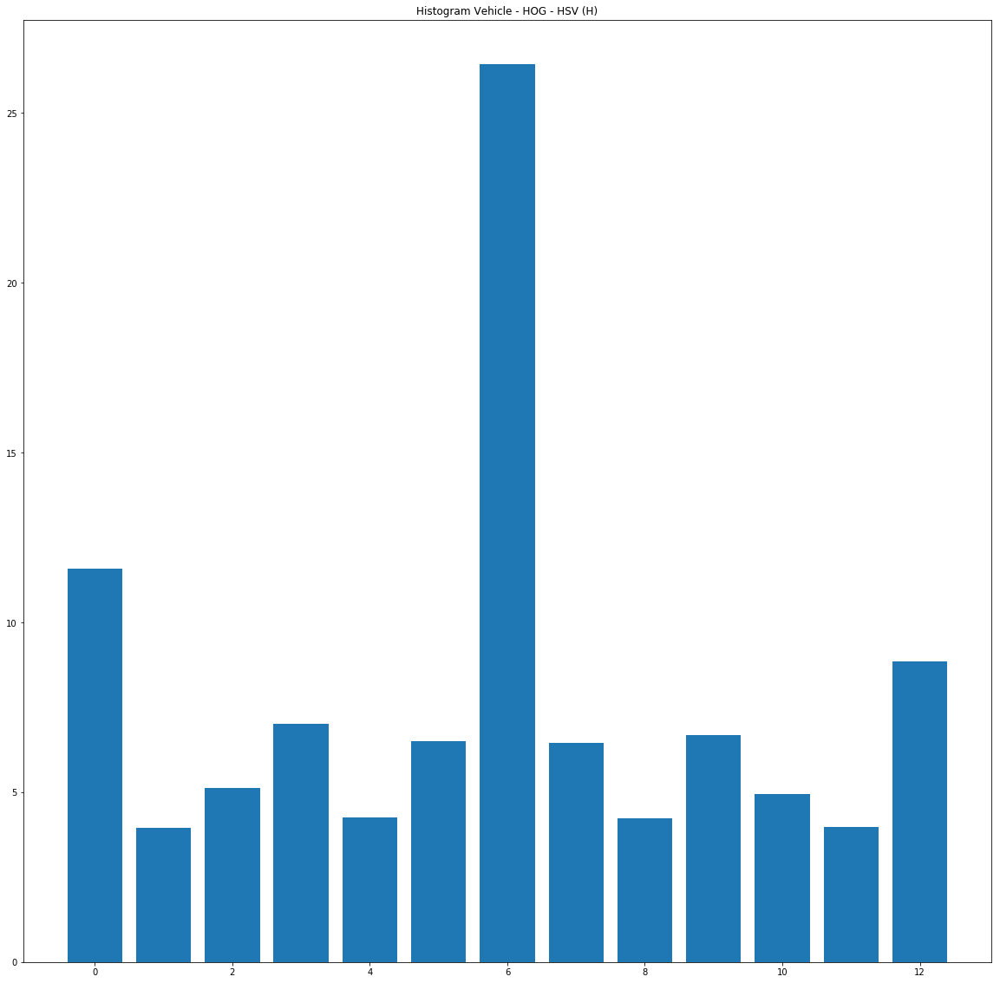

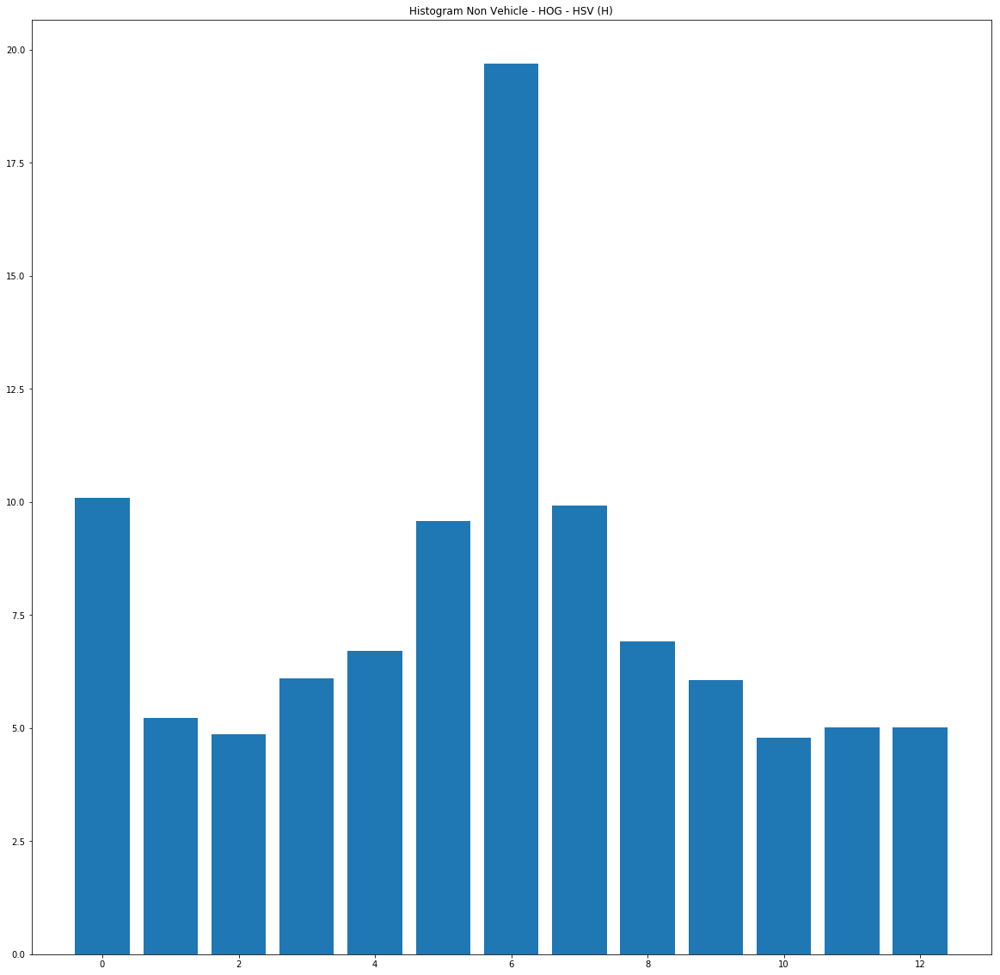

In [397]:
bars=np.arange(0,orient)
fig = plt.bar(bars, np.sum(np.array(v_hog_hsv_h_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Vehicle - HOG - HSV (H)')

plt.show()

fig = plt.bar(bars, np.sum(np.array(nv_hog_hsv_h_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Non Vehicle - HOG - HSV (H)')

plt.show()

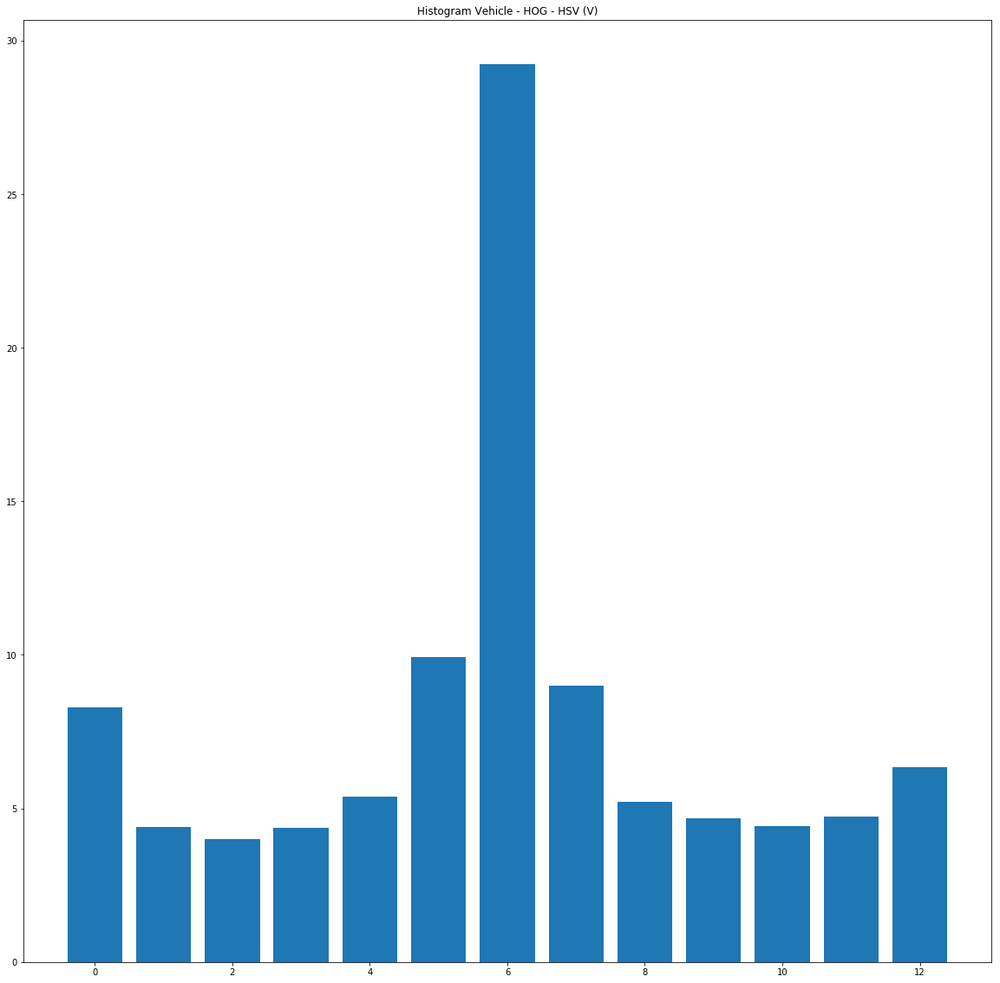

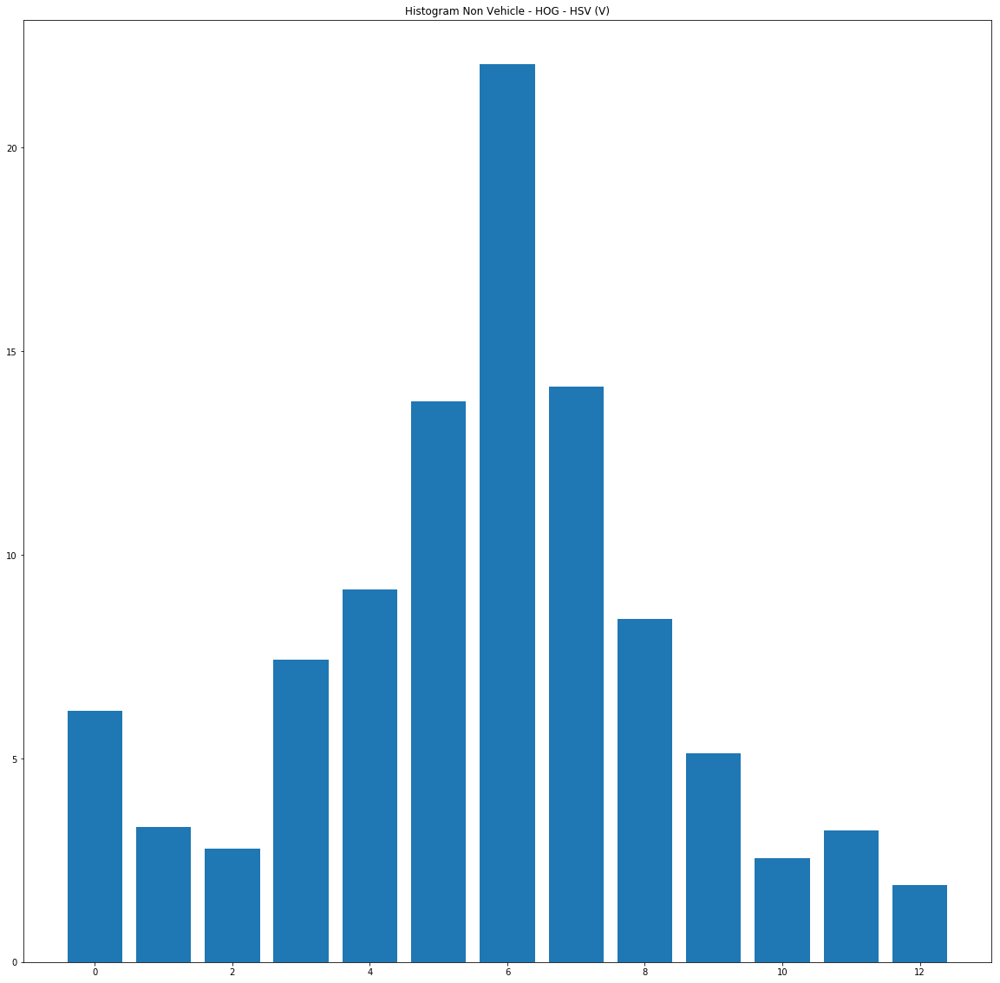

In [398]:
bars=np.arange(0,orient)
fig = plt.bar(bars, np.sum(np.array(v_hog_hsv_v_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Vehicle - HOG - HSV (V)')

plt.show()

fig = plt.bar(bars, np.sum(np.array(nv_hog_hsv_v_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Non Vehicle - HOG - HSV (V)')

plt.show()

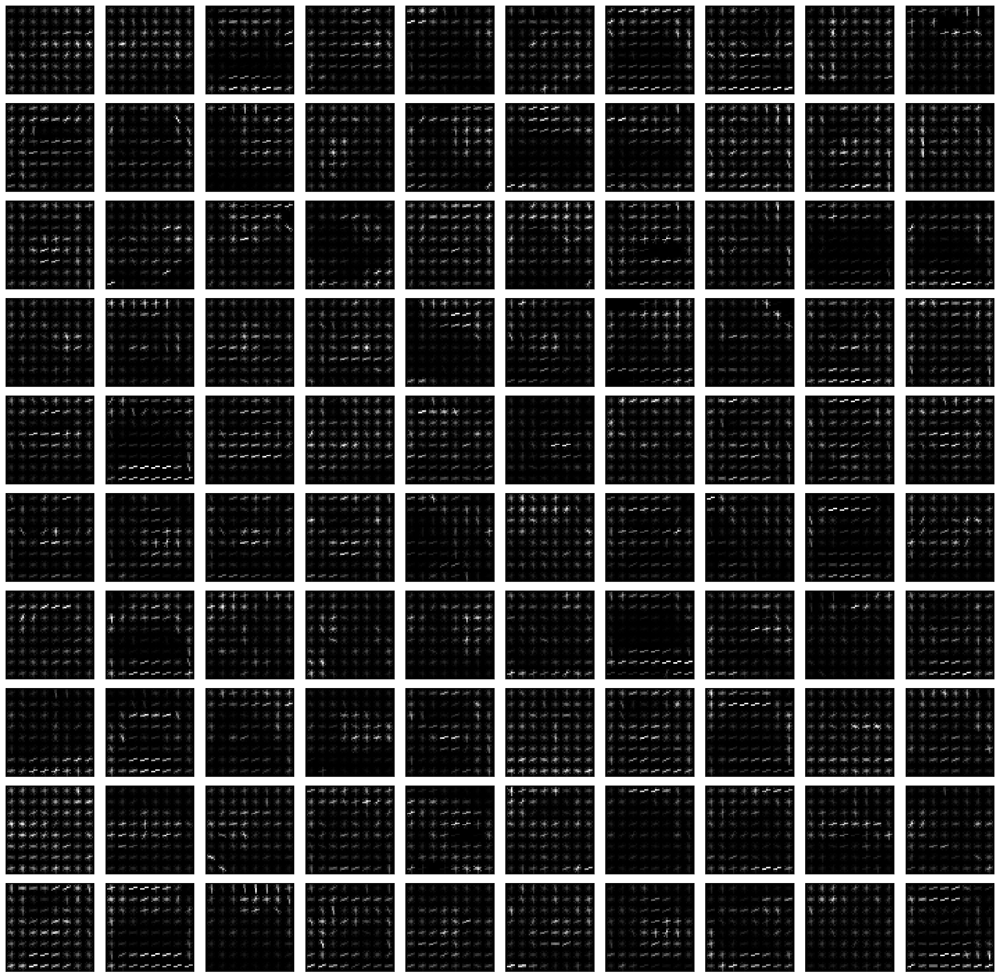

In [399]:
showImages(v_hog_hls_s_imgs, imgs_row, imgs_col, cmap='gray')

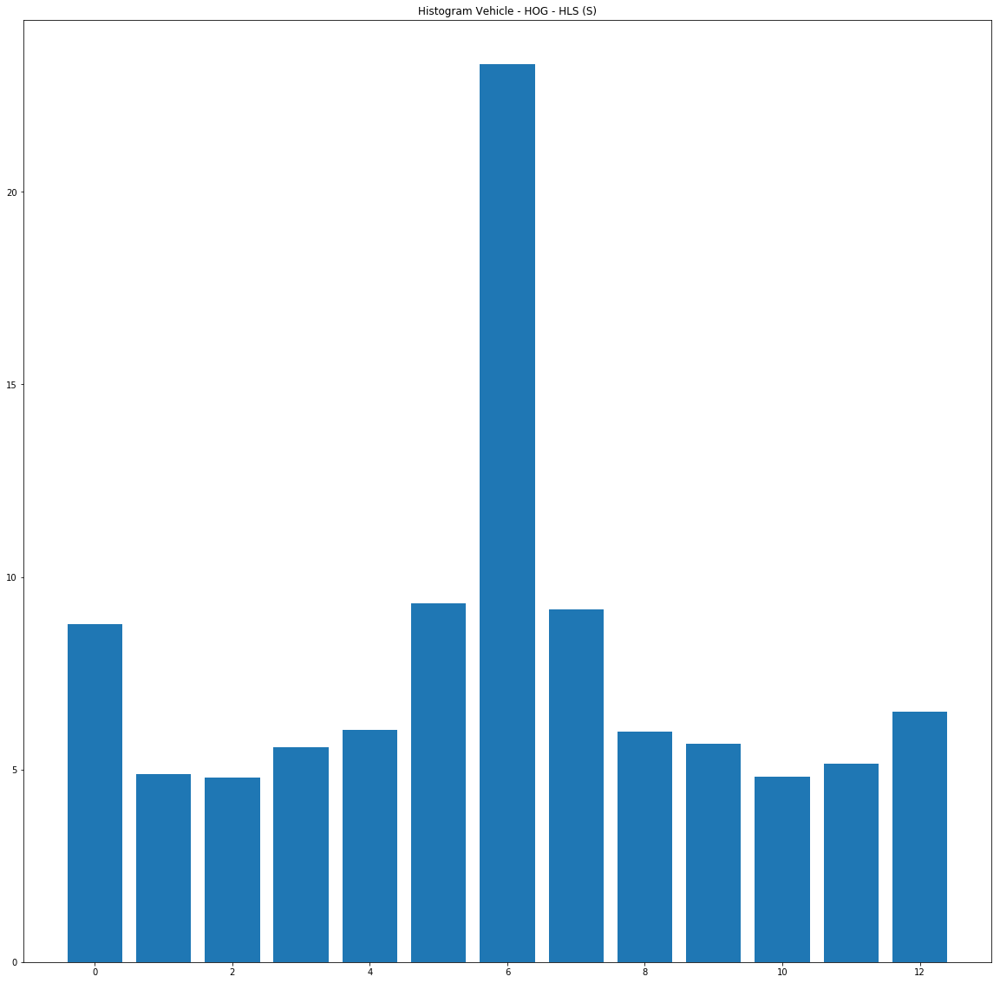

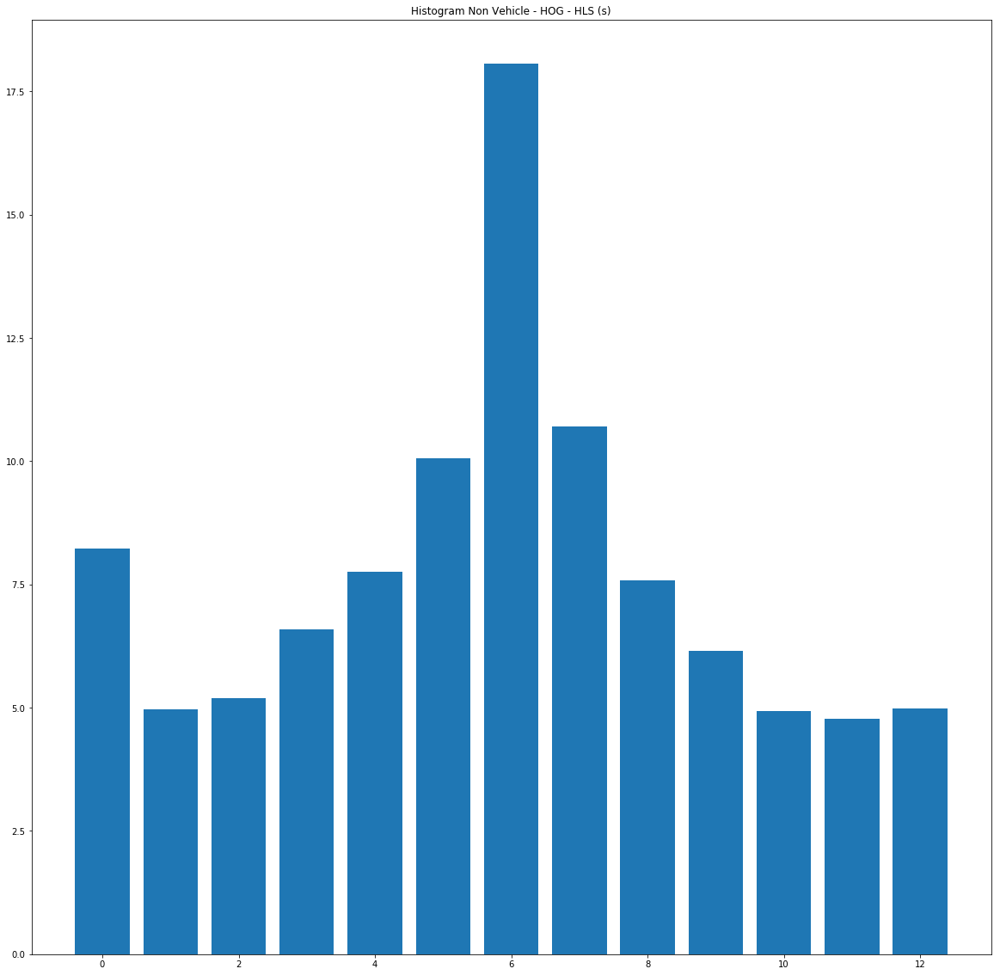

In [400]:
bars=np.arange(0,orient)
fig = plt.bar(bars, np.sum(np.array(v_hog_hls_s_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Vehicle - HOG - HLS (S)')

plt.show()

fig = plt.bar(bars, np.sum(np.array(nv_hog_hls_s_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Non Vehicle - HOG - HLS (s)')

plt.show()

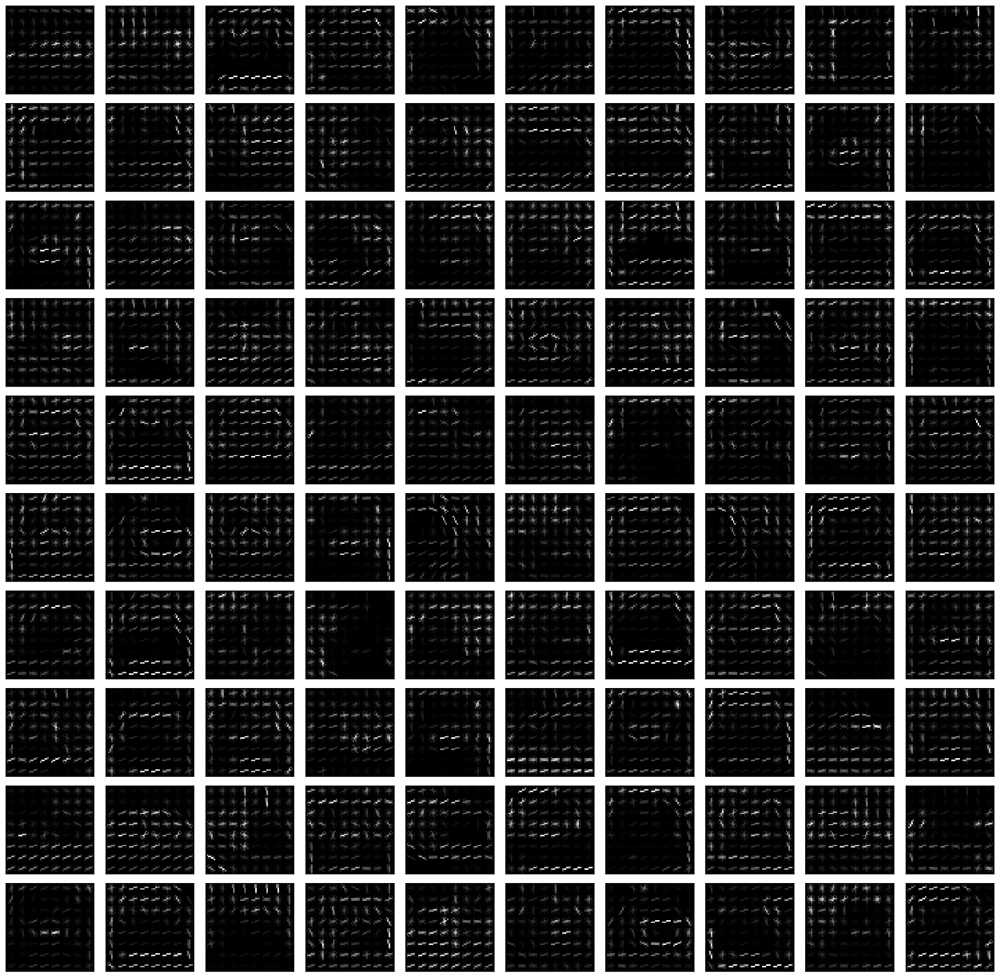

In [401]:
showImages(v_hog_hls_v_imgs, imgs_row, imgs_col, cmap='gray')

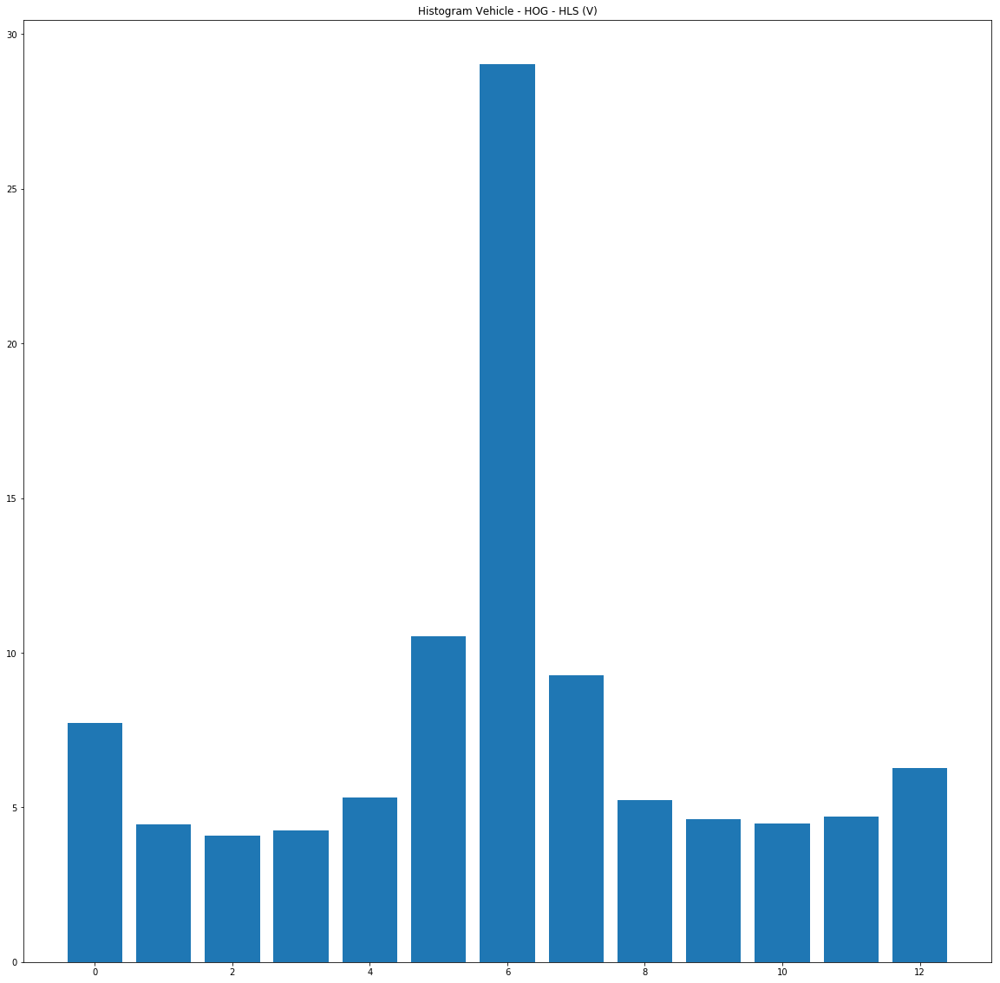

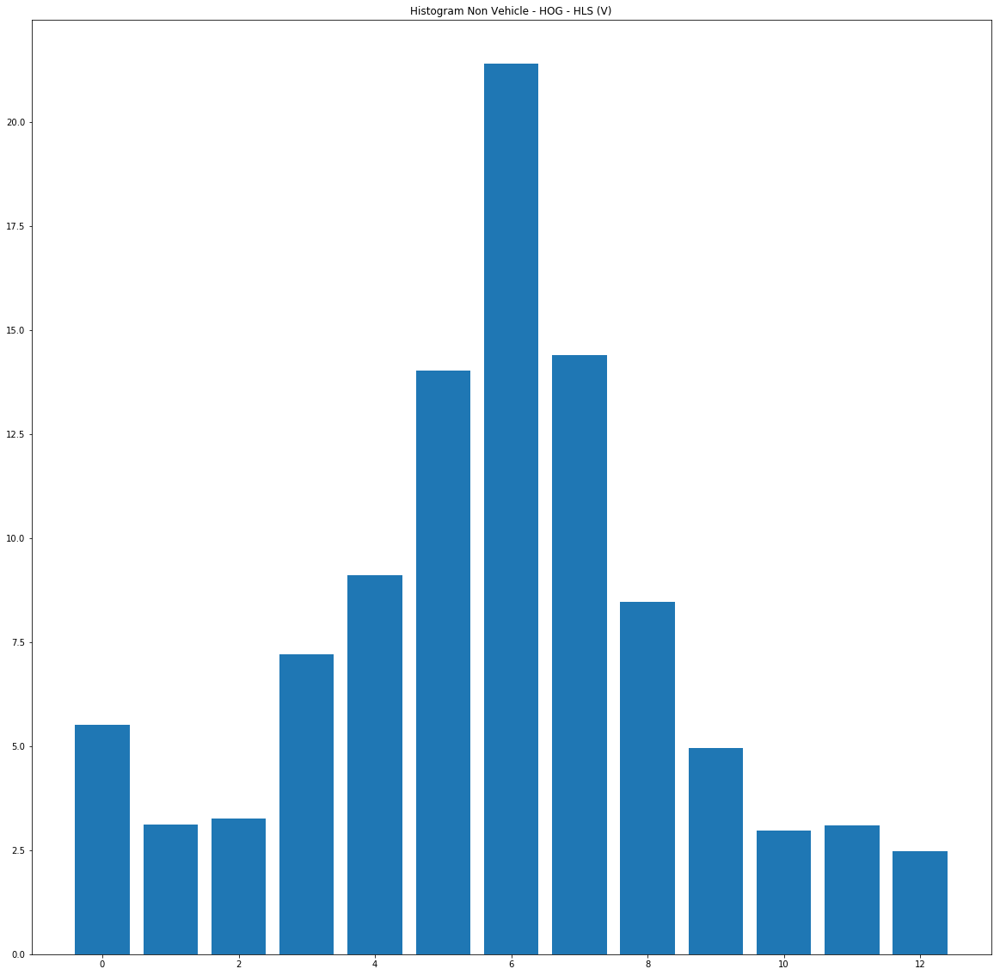

In [402]:
bars=np.arange(0,orient)
fig = plt.bar(bars, np.sum(np.array(v_hog_hls_v_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Vehicle - HOG - HLS (V)')

plt.show()

fig = plt.bar(bars, np.sum(np.array(nv_hog_hls_v_features).reshape((-1,orient)), axis=0))
plt.title('Histogram Non Vehicle - HOG - HLS (V)')

plt.show()

In [34]:
f_ex = Feature(sample_size=(64,64), hist_bins=None, spatial_size=None, useMeanAndStd=False, cspaces=['HLS','YUV'], useHog=True, hog_bins=9, hog_cell_size=8, hog_block_size=2)

In [35]:
features = f_ex.extract([v_imgs[0]])

NameError: name 'v_imgs' is not defined

In [199]:
print(len(features[0]))
#spatial_features = features[0][0:12288]
#mean_std = features[0][12288:12294]
hist_color = features[0][0:192]
hog0 = features[0][12390:14938]
hog1 = features[0][14938:17486]
hog2 = features[0][17486:20034]
hog_totals = features[0][20034:20073]
#hog_mean_std = features[0][20073:20079]
print(spatial_features, np.min(spatial_features))
print(mean_std)
print(hist_color)
print(hog0, hog1, hog2)
print(hog_totals)
#print(hog_mean_std)

17934
[  7.38000000e+02   3.70000000e+01   2.90000000e+01 ...,   1.85893058e-02
   8.56106262e-02   2.03445818e-02] 0.0
[ 0.00758345  0.00440049  0.01191386  0.00410248  0.00209843  0.00634725]
[ 0.0059211   0.0038524   0.01332637  0.00277332  0.00469705  0.01416886
  0.01279777  0.00928549  0.03115907  0.00893043  0.01687604  0.01602246
  0.01436516  0.0097923   0.01306955  0.01472571  0.0028635   0.00925385
  0.01161347  0.02361466  0.04821801  0.01555125  0.01231284  0.0193506
  0.0157546   0.0043616   0.00651052  0.0083179   0.01423297  0.00993054
  0.00701983  0.00714977  0.00279945  0.01355355  0.00641692  0.00823852
  0.00281078  0.02878534  0.00192993  0.00360047  0.00220505  0.00262837
  0.00957351  0.00117904  0.00279025  0.00432622  0.0057792   0.00213823
  0.0027853   0.00223212  0.00551684  0.01488981  0.00387872  0.00772497
  0.01533397  0.01458406  0.01414676  0.01023234  0.00652434  0.01074501
  0.00228473  0.00656992  0.00222637  0.01381712  0.06363297  0.01512179
  0.

96
[ 17 305 260 528 848 562 705 385 131  84  62  37  35  34  44  31  10   7
   5   3   1   1   0   0   1   0   0   0   0   0   0   0  26 277 236 396
 613 700 516 584 279  81  66  50  41  33  32  29  15  27  35  32  16   4
   5   2   0   0   1   0   0   0   0   0   1 216 272 305 447 594 584 460
 503 224  59  48  41  52  35  33  26  24  22  18  12  10  28  30  23  16
  11   2   0   0   0   0]


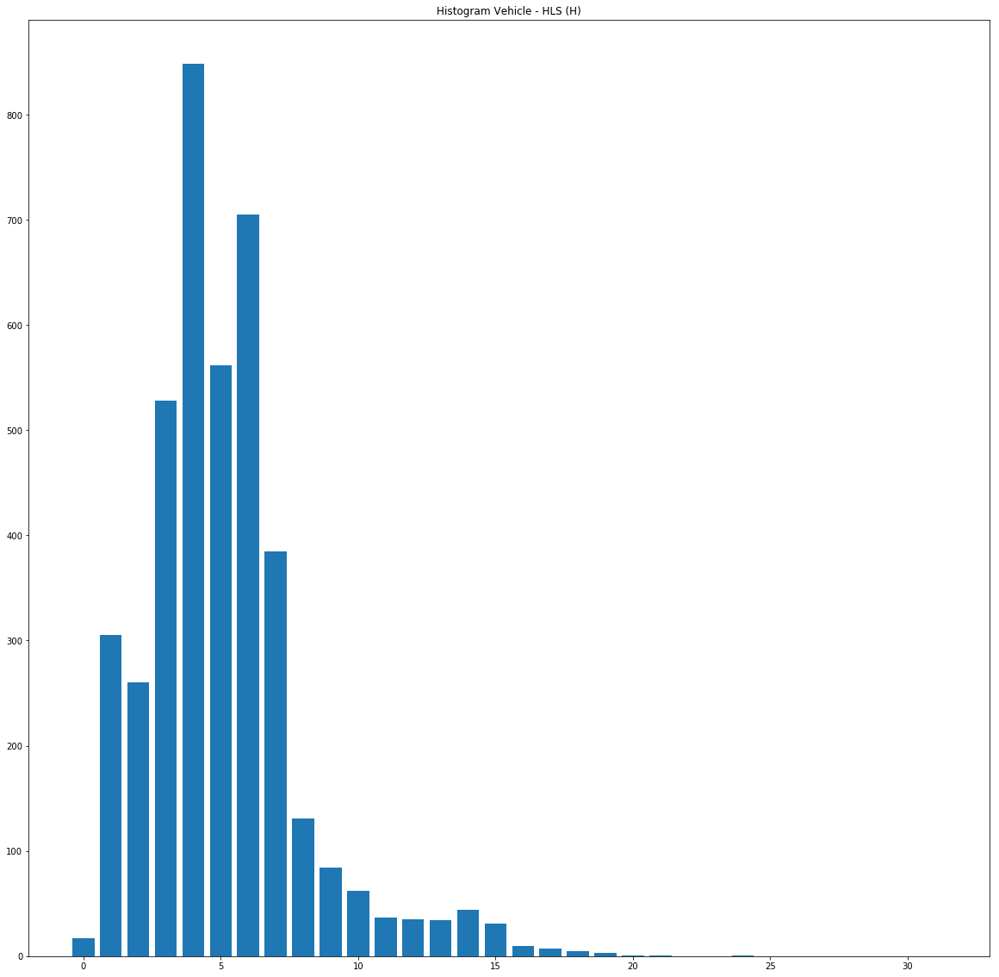

In [406]:
hist = Feature.color_hist(v_imgs[0])
print(len(hist[4]))
print(hist[4])
bars=np.arange(0,32)
fig = plt.bar(bars, hist[0][0])
plt.title('Histogram Vehicle - HLS (H)')

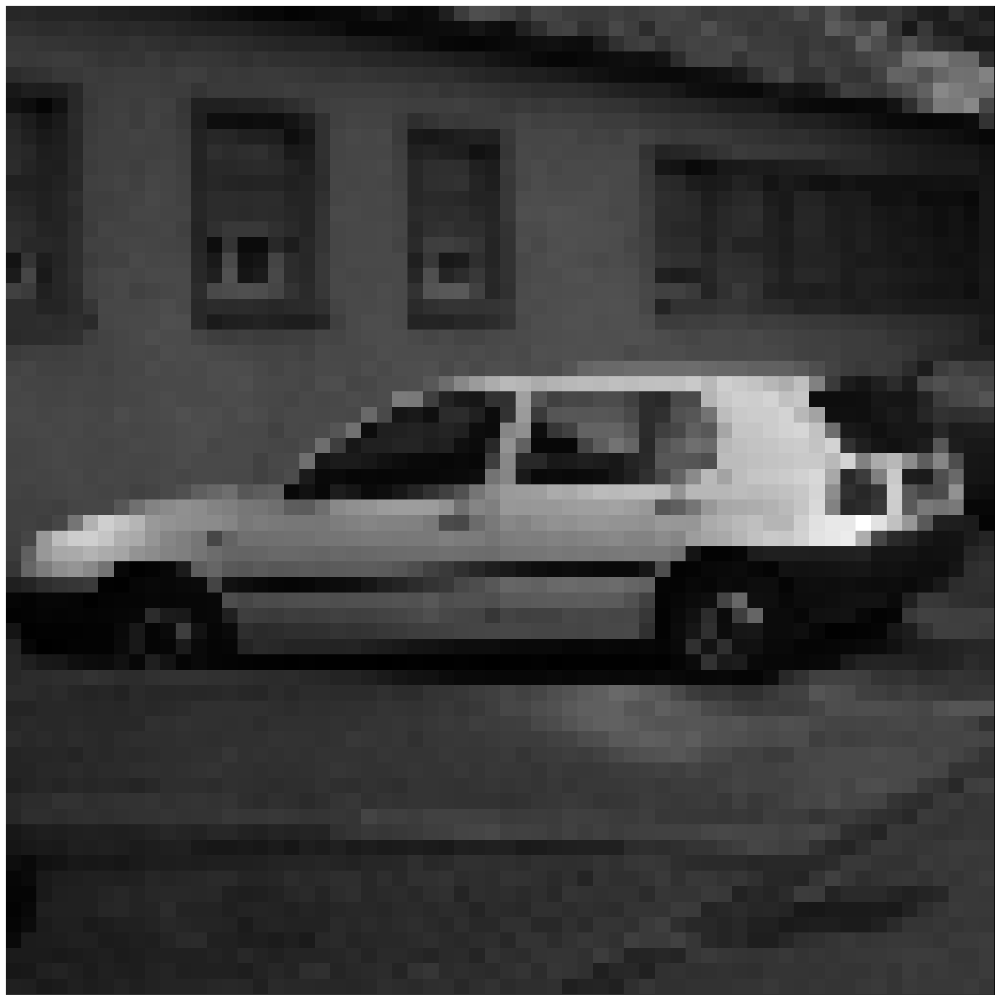

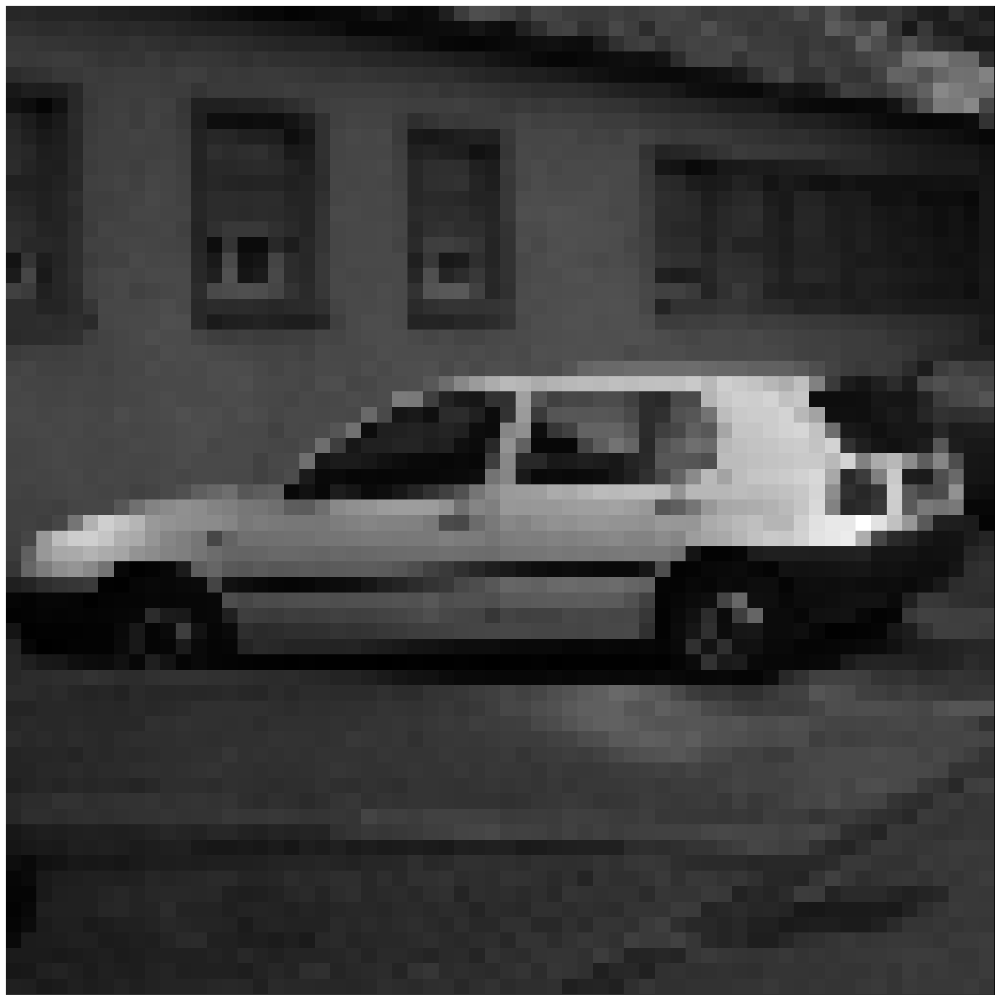

(64, 64, 3)


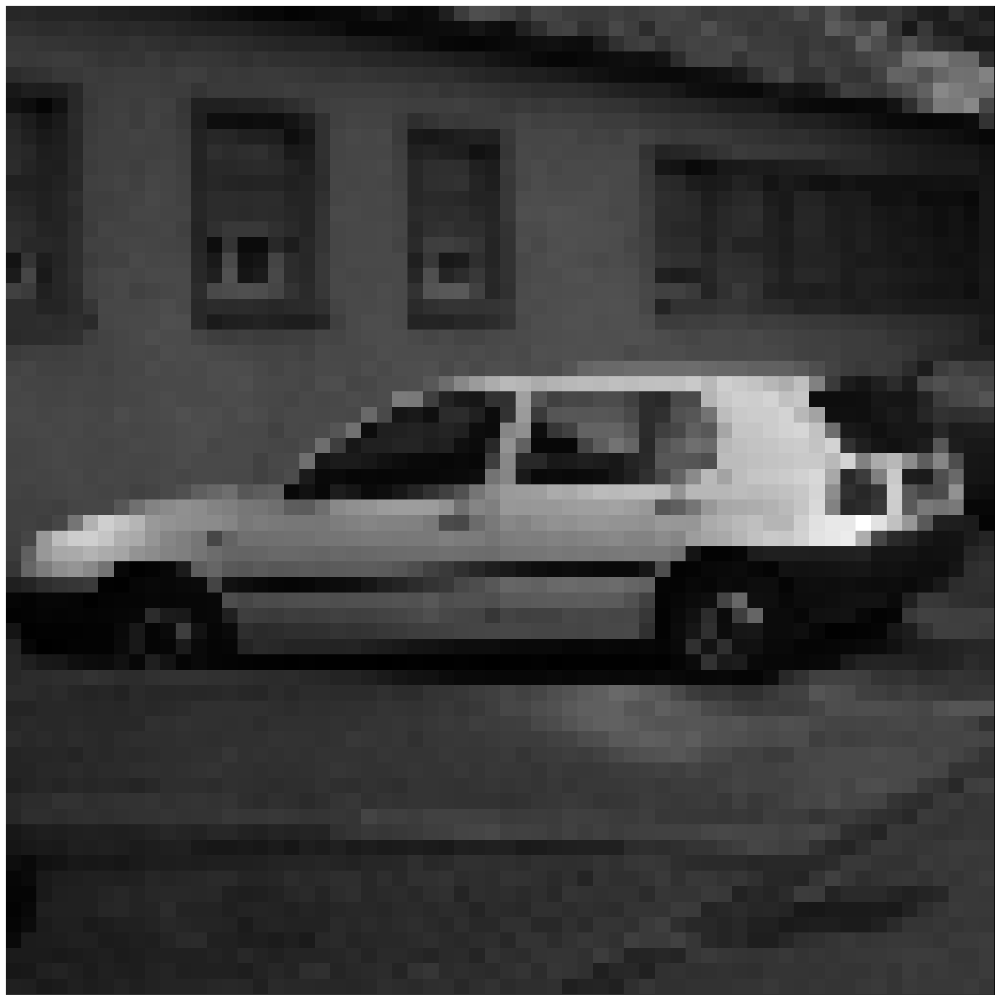

12288
[ 0.5         0.14509805  0.02702702 ...,  0.58888888  0.19019608
  0.15463917]
[ 0.5         0.14509805  0.02702702 ...,  0.58888888  0.19019608
  0.15463917]
[ True  True  True ...,  True  True  True]


In [407]:
showImages([v_hls_imgs[0][:,:,1]], 1, 1, cmap='gray')
spatial = Feature.bin_spatial(v_hls_imgs[0])
newimg = spatial.reshape((64, 64, 3))
showImages([newimg[:,:,1]], 1, 1, cmap='gray')
newimg = spatial_features.reshape((64, 64, 3))
print(newimg.shape)
showImages([newimg[:,:,1]], 1, 1, cmap='gray')
print(len(spatial))
#print(len(features[0][0]))
print(spatial)
print(spatial_features)
print(spatial == spatial_features)

In [408]:
print(features[0])
print(f_ex.transform(features[0]))

[ 0.5         0.14509805  0.02702702 ...,  0.03007644  0.01922985
  0.01420034]
[-0.01677193 -0.0362695  -0.04275607 ..., -0.04258854 -0.04318443
 -0.04346074]


/Volumes/DATA/work/miniconda3/envs/CarND-Traffic-Sign-Classifier-Project/lib/python3.5/site-packages/sklearn/preprocessing/data.py:586: DeprecationWarning: Passing 1d arrays as data is deprecated in 0.17 and will raise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.
  warnings.warn(DEPRECATION_MSG_1D, DeprecationWarning)
/Volumes/DATA/work/miniconda3/envs/CarND-Traffic-Sign-Classifier-Project/lib/python3.5/site-packages/sklearn/preprocessing/data.py:649: DeprecationWarning: Passing 1d arrays as data is deprecated in 0.17 and will raise ValueError in 0.19. Reshape your data either using X.reshape(-1, 1) if your data has a single feature or X.reshape(1, -1) if it contains a single sample.
  warnings.warn(DEPRECATION_MSG_1D, DeprecationWarning)


In [89]:
v_paths_train = glob.glob('./data/vehicles-*/*.png')

In [92]:
v_sample = np.random.choice(len(v_paths), 5000)
nv_sample = np.arange(0,len(nv_paths))

cars_sample = []
non_cars_sample = []

#for path in v_paths_train:
#    cars_sample.append(mpimg.imread(path))
for path in np.array(v_paths)[v_sample]:
    cars_sample.append(mpimg.imread(path))
for path in np.array(nv_paths)[nv_sample]:
    non_cars_sample.append(mpimg.imread(path))

In [275]:
f_ex = Feature(sample_size=(64,64), spatial_size=None, useMeanAndStd=False, cspaces=['YUV', 'HLS'], useHog=True, hog_bins=9, hog_cell_size=8, hog_block_size=2)

In [276]:
classifier = Classifier(epochs=4000)
#classifier.load('reinforcement_model')

In [277]:
trainer = Trainer(f_ex, classifier)

In [278]:
features, labels = trainer.prepare(classes=[cars_sample, non_cars_sample], dump='features.pkl',augment={'flip': True})
#features, labels = trainer.prepare(dump='features.pkl', load='features.pkl')
#groups = trainer.split(features, labels, test_ratio=0.2)

print(len(features), len(cars_sample), len(non_cars_sample))
assert(len(features) == (len(cars_sample) + len(non_cars_sample)) * 2)
#randomly split positive examples
groups_positive = trainer.split(features[0:len(cars_sample)*2], labels[0:len(cars_sample)*2], test_ratio=0.2)
#use every other sample for negative cases

#positive_samples_train = features[0:len(v_paths_train)*2]
#positive_labels_train = labels[0:len(v_paths_train)*2]
#positive_samples_test = features[len(v_paths_train)*2:len(cars_sample)*2]
#positive_labels_test = labels[len(v_paths_train)*2:len(cars_sample)*2]

#groups_positive = [
#    (positive_samples_train, positive_labels_train),
#    (positive_samples_test, positive_labels_test)
#]

negative_samples_train = features[len(cars_sample)*2:len(features)*2:2]
negative_labels_train = labels[len(cars_sample)*2:len(features)*2:2]
negative_samples_test = features[(len(cars_sample)+1)*2:len(features)*2:2]
negative_labels_test = labels[(len(cars_sample)+1)*2:len(features)*2:2]

groups_negative = [
    (negative_samples_train, negative_labels_train),
    (negative_samples_test, negative_labels_test)
]

#print(groups_positive)
#print(groups_negative)

X_train_group = np.concatenate((groups_positive[0][0], groups_negative[0][0]))
y_train_group = np.concatenate((groups_positive[0][1], groups_negative[0][1]))
X_test_group = np.concatenate((groups_positive[1][0], groups_negative[1][0]))
y_test_group = np.concatenate((groups_positive[1][1], groups_negative[1][1]))

groups = [
    (X_train_group, y_train_group),
    (X_test_group, y_test_group), 
]
print(len(groups[0][0]), len(groups[0][1]), len(groups[1][0]), len(groups[1][1]))

Loaded  5000  positive examples , total with augmentation  10000
Loaded  8968  negative examples , total with augmentation  17936
27936 5000 8968
Split train/test, train  8000 , test  2000
   positive: train  8000 , test  2000
   negative: train  0 , test  0
16968 16968 10967 10967


In [353]:
trainer.train(groups)

-- Epoch 1
Norm: 78.65, NNZs: 10638, Bias: -233.405089, T: 16968, Avg. loss: 0.013382
Total training time: 0.18 seconds.
Training time 0.30973291397094727, accuracy 0.998


{'accuracy': 0.99790279930701198,
 'scores': array([  571.41279045,   188.82970097,   520.23730517, ..., -1016.89816681,
         -754.58427914, -1261.99645102]),
 'test_time': 0.163254976272583,
 'time': 0.30973291397094727}

In [186]:
print(len(X_train_group[0]))

17934


In [20]:
nv_sample_test = np.random.choice(len(nv_paths), 3000)
v_sample_test = np.random.choice(len(v_paths), 3000)
nv_samples_test = []
v_samples_test = []
for path in np.array(nv_paths)[nv_sample_test]:
    nv_samples_test.append(mpimg.imread(path))
for path in np.array(v_paths)[v_sample_test]:
    v_samples_test.append(mpimg.imread(path))
test_features, test_labels = trainer.prepare(classes=[v_samples_test, nv_samples_test])
results = trainer.test(test_features, test_labels)
print(results)

Loaded  3000  positive examples , total with augmentation  3000
Loaded  3000  negative examples , total with augmentation  3000
Test time 0.1367340087890625, accuracy 0.997
{'time': 0.1367340087890625, 'scores': array([ 7293.17122833,  8401.93484808,  6598.35512493, ..., -3157.85705048,
       -5287.24623238, -6223.40537532]), 'accuracy': 0.99650000000000005}


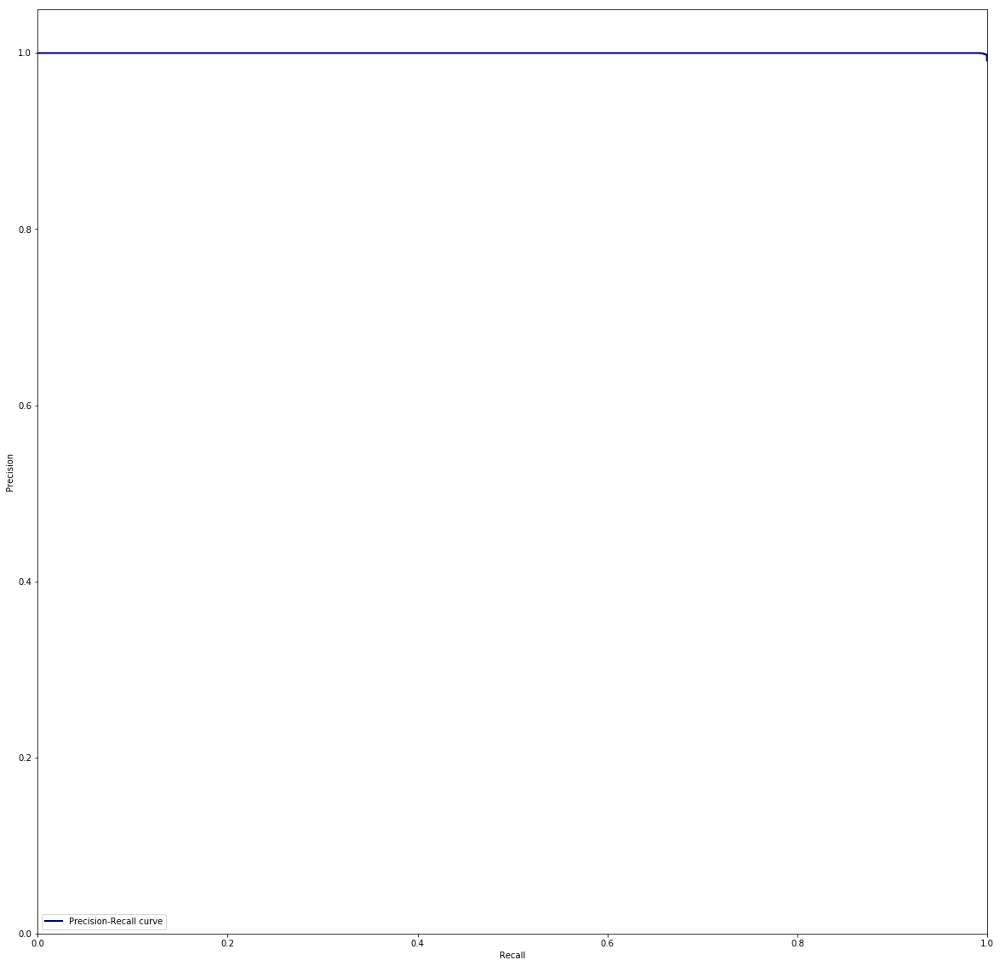

In [39]:
precision, recall, _ = sklearn.metrics.precision_recall_curve(test_labels, results['scores'], pos_label=None, sample_weight=None)
plt.clf()
plt.plot(recall, precision, lw=2, color='navy',
         label='Precision-Recall curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
#plt.title('Precision-Recall example: AUC={0:0.2f}'.format(average_precision[0]))
plt.legend(loc="lower left")
plt.show()

0.0 1.0


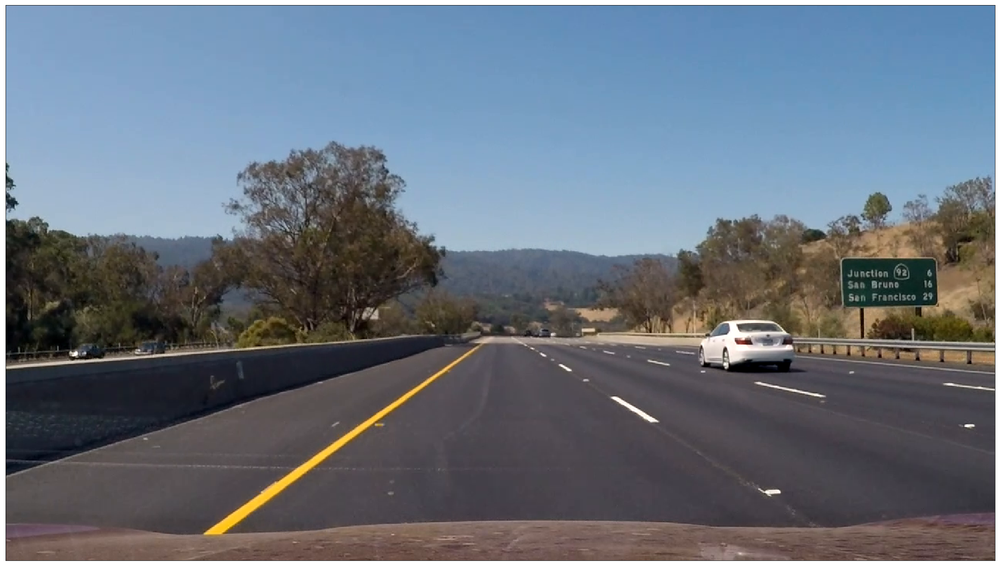

In [344]:
search_img_path = glob.glob('./data/video-frames/frame0020.png')
search_img = mpimg.imread(search_img_path[0])
print(np.min(search_img), np.max(search_img))
showImages([search_img], 1, 1)

In [283]:
subimg = search_img[360:680,0:790].copy()
negative_windows = Search.slide_window(subimg, xy_window=(100, 100), xy_overlap=(0.875, 0.875))
negative_windows = np.array(negative_windows)
negative_dataset = Search.extract_pixels_from_windows(subimg, negative_windows, (64, 64))
negative_test_features, negative_test_labels = trainer.prepare(classes=[None, negative_dataset])
results = trainer.test(negative_test_features, negative_test_labels)

error: /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/imgwarp.cpp:3492: error: (-215) ssize.width > 0 && ssize.height > 0 in function resize


In [284]:
subimg = search_img[398:507,808:946].copy()
positive_windows = Search.slide_window(subimg, xy_window=(64, 64), xy_overlap=(0.875, 0.875))
positive_windows = np.array(positive_windows)
positive_dataset = Search.extract_pixels_from_windows(subimg, positive_windows, (64, 64))
positive_test_features, positive_test_labels = trainer.prepare(classes=[positive_dataset, None])
results = trainer.test(positive_test_features, positive_test_labels)

error: /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/imgwarp.cpp:3492: error: (-215) ssize.width > 0 && ssize.height > 0 in function resize


In [338]:
search = Search(f_ex, trainer, 256, 76, 8, overlap_factor=0.875)

In [374]:
windows, scores, windows_count = search.search(search_img, ((0, 360), (1280, 640)))
print('Number of hits: ', len(windows), ' min/max score {:.3f}, {:.3f}'.format(np.min(scores), np.max(scores)))

256
33 33
192
184 184
144
512 512
112
1092 1092
80
2541 2541
Number of hits:  2393  min/max score 4.750, 61658.809


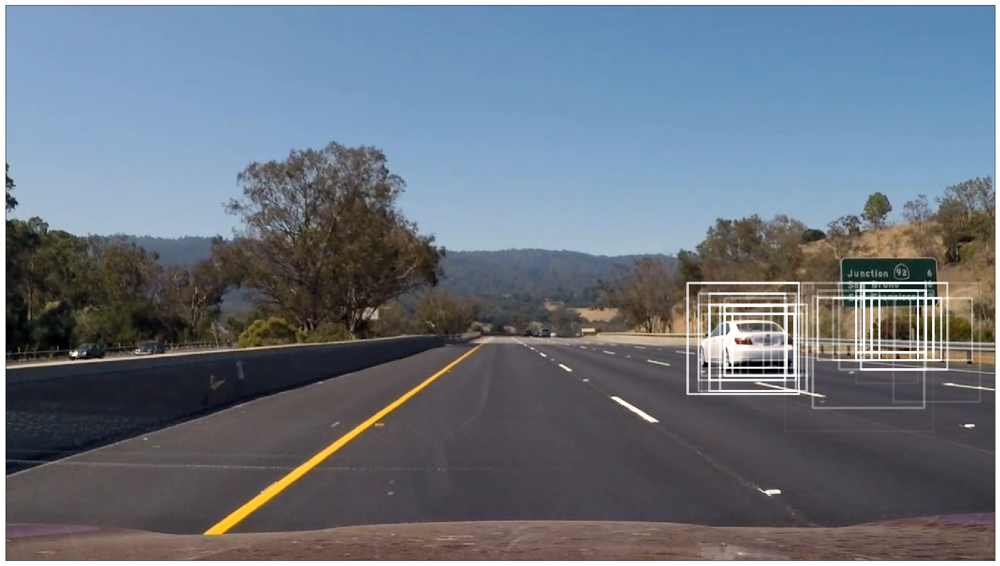

In [369]:
score_alphas = scores / np.max(scores)
bbox_img = Search.draw_boxes(search_img, windows, alphas=score_alphas, thick=2)
showImages([bbox_img], 1, 1)

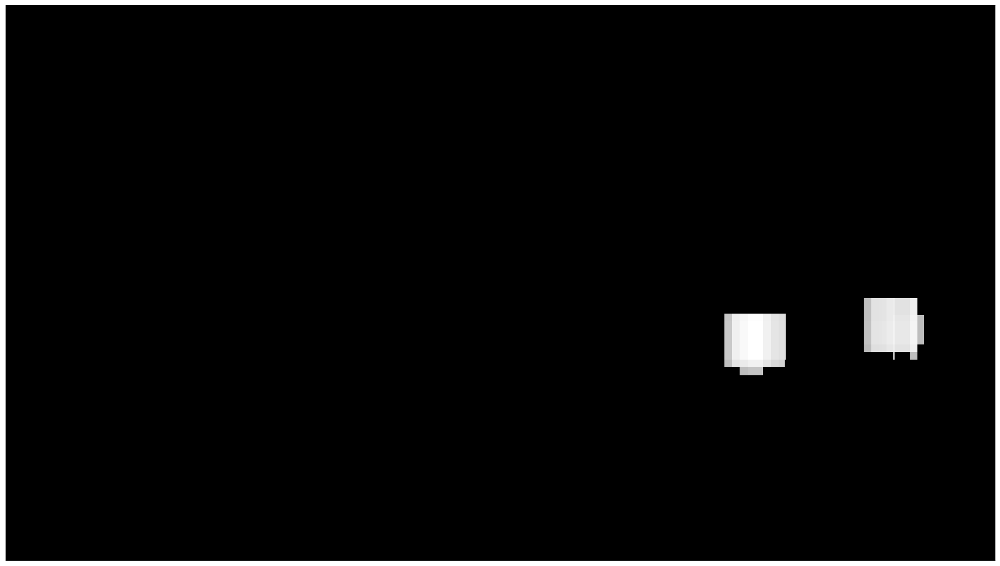

In [372]:
heatmap = np.zeros_like(search_img, dtype=np.float32)
votes = np.zeros_like(search_img)
search.add_heat(heatmap, votes, windows, scores)
votes[votes == 0] = 1
heatmap[heatmap < 4000] = 0
heatmap /= np.max(heatmap) + 0.00001
heatmap[heatmap < 0.2] = 0
showImages([heatmap], 1, 1)

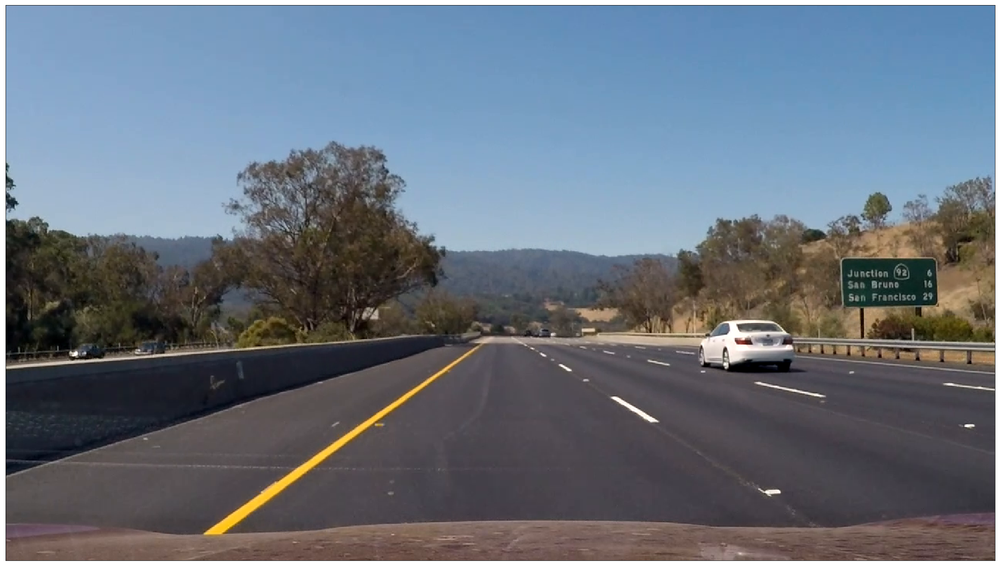

In [371]:
car_bboxs = search.filter_boxes(heatmap)
car_bbox_img = Search.draw_boxes(search_img, car_bboxs, color=(0, 255, 0), alpha=0.75, thick=2)
showImages([car_bbox_img], 1, 1)

In [373]:
classifier.load('reinforcement_model_1')

In [313]:
a = np.ones((3, 3, 3)) / 3
b = np.ones((3, 3, 3)) / 4

print(a, b)
print(np.sum(np.array([a, b]), axis=0))


[[[ 0.33333333  0.33333333  0.33333333]
  [ 0.33333333  0.33333333  0.33333333]
  [ 0.33333333  0.33333333  0.33333333]]

 [[ 0.33333333  0.33333333  0.33333333]
  [ 0.33333333  0.33333333  0.33333333]
  [ 0.33333333  0.33333333  0.33333333]]

 [[ 0.33333333  0.33333333  0.33333333]
  [ 0.33333333  0.33333333  0.33333333]
  [ 0.33333333  0.33333333  0.33333333]]] [[[ 0.25  0.25  0.25]
  [ 0.25  0.25  0.25]
  [ 0.25  0.25  0.25]]

 [[ 0.25  0.25  0.25]
  [ 0.25  0.25  0.25]
  [ 0.25  0.25  0.25]]

 [[ 0.25  0.25  0.25]
  [ 0.25  0.25  0.25]
  [ 0.25  0.25  0.25]]]
[[[ 0.58333333  0.58333333  0.58333333]
  [ 0.58333333  0.58333333  0.58333333]
  [ 0.58333333  0.58333333  0.58333333]]

 [[ 0.58333333  0.58333333  0.58333333]
  [ 0.58333333  0.58333333  0.58333333]
  [ 0.58333333  0.58333333  0.58333333]]

 [[ 0.58333333  0.58333333  0.58333333]
  [ 0.58333333  0.58333333  0.58333333]
  [ 0.58333333  0.58333333  0.58333333]]]
